# Exclusive Bach Midi

In [1]:
import requests
import re
from bs4 import BeautifulSoup
import wget
import pandas as pd

## Scraping from Classical Piano Midi Page

In [3]:
# function to download midi files after retrieving composer links
def download_links_from_composer_links(composer_str):
#     request composer's page based on link retrieved in link.get('href')
    html_page = requests.get(f"http://www.piano-midi.de/{composer_str}")
#     transform with bs4 for html read out 
    soup = BeautifulSoup(html_page.content, 'html.parser')
#     search html for midi file link in each table and download
    for table in soup.findAll('table', 'midi'):
        for link in table.findAll('a'):
#           print each file found per composer
            print(link.get('href')[-3:])
#           download only the midi files
            if link.get('href')[-3:] == 'mid':
                wget.download('http://www.piano-midi.de/{}'.format(link.get('href')))

In [4]:
# set variable to Classical Piano Midi webpage
html_page = requests.get("http://www.piano-midi.de/midi_files.htm")
# from webpage, retrieve table of composers
composers_soup = BeautifulSoup(html_page.content, 'html.parser')
composer_table = composers_soup.find('table', 'midi')
# loop through table of composers and retrieve chopin's link to feed to dl function
for link in composer_table.findAll('a', attrs={'href': 'bach.htm'}):
    print(link.get('href'))
    # use function to pass composer links
    download_links_from_composer_links(link.get('href'))

bach.htm
mid
mid
mp3
mid
mid
mp3
mid
mid
mp3


## Scraping from Midi World

In [5]:
# function to parse through Midiworld.com and pull Bach's page
def find_bach(str):
    html_pg = requests.get(str)
    composer_pg = BeautifulSoup(html_pg.content, 'html.parser')
    find_it = composer_pg.findAll('a', attrs={'href': 'mw_bach.htm'})
    for i in find_it:
        comprs = i.get('href')
    base = 'https://www.midiworld.com/'
    end = comprs
    bach = base + end
    return bach

In [6]:
find_bach('https://www.midiworld.com/composers.htm')

'https://www.midiworld.com/mw_bach.htm'

In [7]:
# running 'find_bach' now that his url is located
bach_html = requests.get(find_bach('https://www.midiworld.com/composers.htm'))
bach_pg = BeautifulSoup(bach_html.content, 'html.parser')
# pulling all links on Bach's page
bach_links = bach_pg.findAll('a', attrs={'href': re.compile("^https://")})
# pulling all Bach midi files 
for link in bach_links:
    if link.get('href')[-3:] == 'mid':
        print(link.get('href'))
        wget.download(link.get('href'))

https://www.midiworld.com/midis/other/bach/bwv772.mid
https://www.midiworld.com/midis/other/bach/bwv773.mid
https://www.midiworld.com/midis/other/bach/bwv774.mid
https://www.midiworld.com/midis/other/bach/bwv775.mid
https://www.midiworld.com/midis/other/bach/bwv776.mid
https://www.midiworld.com/midis/other/bach/bwv777.mid
https://www.midiworld.com/midis/other/bach/bwv778.mid
https://www.midiworld.com/midis/other/bach/bwv779.mid
https://www.midiworld.com/midis/other/bach/bwv780.mid
https://www.midiworld.com/midis/other/bach/bwv781.mid
https://www.midiworld.com/midis/other/bach/bwv782.mid
https://www.midiworld.com/midis/other/bach/bwv783.mid
https://www.midiworld.com/midis/other/bach/bwv784.mid
https://www.midiworld.com/midis/other/bach/bwv785.mid
https://www.midiworld.com/midis/other/bach/bwv786.mid
https://www.midiworld.com/midis/other/bach/bwv787.mid
https://www.midiworld.com/midis/other/bach/bwv788.mid
https://www.midiworld.com/midis/other/bach/bwv789.mid
https://www.midiworld.com/mi

In [8]:
# scraping titile of peices from Bach midilinks
bach_titles = []
for link in bach_links:
    href = link.get('href')
    bach_titles.append(link.string)

In [9]:
del bach_titles[0]

In [10]:
df_bach_titles = pd.DataFrame(bach_titles)

In [11]:
df_bach_titles = df_bach_titles.rename(columns = {0: 'Title'})

In [12]:
df_bach_titles

,Title
0,Inventio 1 [BWV 772]
1,Inventio 2 [BWV 773]
2,Inventio 3 [BWV 774]
3,Inventio 4 [BWV 775]
4,Inventio 5 [BWV 776]
...,...
282,Prelude & Fugue No.35 in F [BWV 880]
283,Prelude & Fugue No.36 in Fmin [BWV 881]
284,Prelude II
285,Prelude XII


In [13]:
bach_track_list = []
for link in bach_links:
    if link.get('href')[-3:] == 'mid':
        bach_track_list.append(link.get('href'))
bach_track_list

['https://www.midiworld.com/midis/other/bach/bwv772.mid',
 'https://www.midiworld.com/midis/other/bach/bwv773.mid',
 'https://www.midiworld.com/midis/other/bach/bwv774.mid',
 'https://www.midiworld.com/midis/other/bach/bwv775.mid',
 'https://www.midiworld.com/midis/other/bach/bwv776.mid',
 'https://www.midiworld.com/midis/other/bach/bwv777.mid',
 'https://www.midiworld.com/midis/other/bach/bwv778.mid',
 'https://www.midiworld.com/midis/other/bach/bwv779.mid',
 'https://www.midiworld.com/midis/other/bach/bwv780.mid',
 'https://www.midiworld.com/midis/other/bach/bwv781.mid',
 'https://www.midiworld.com/midis/other/bach/bwv782.mid',
 'https://www.midiworld.com/midis/other/bach/bwv783.mid',
 'https://www.midiworld.com/midis/other/bach/bwv784.mid',
 'https://www.midiworld.com/midis/other/bach/bwv785.mid',
 'https://www.midiworld.com/midis/other/bach/bwv786.mid',
 'https://www.midiworld.com/midis/other/bach/bwv787.mid',
 'https://www.midiworld.com/midis/other/bach/bwv788.mid',
 'https://www.

In [14]:
df_bach_track_list = pd.DataFrame(bach_track_list)

In [15]:
df_bach_track_list = df_bach_track_list.rename(columns={0: 'Midi_link'})

In [16]:
df_bach_titles['Midi_Link'] = df_bach_track_list

In [17]:
df_bach_titles

,Title,Midi_Link
0,Inventio 1 [BWV 772],https://www.midiworld.com/midis/other/bach/bwv...
1,Inventio 2 [BWV 773],https://www.midiworld.com/midis/other/bach/bwv...
2,Inventio 3 [BWV 774],https://www.midiworld.com/midis/other/bach/bwv...
3,Inventio 4 [BWV 775],https://www.midiworld.com/midis/other/bach/bwv...
4,Inventio 5 [BWV 776],https://www.midiworld.com/midis/other/bach/bwv...
...,...,...
282,Prelude & Fugue No.35 in F [BWV 880],https://www.midiworld.com/midis/other/bach/bwv...
283,Prelude & Fugue No.36 in Fmin [BWV 881],https://www.midiworld.com/midis/other/bach/bwv...
284,Prelude II,https://www.midiworld.com/midis/other/bach/pre...
285,Prelude XII,https://www.midiworld.com/midis/other/bach/prl...


## Parsing Files into Sequences
using Music21 and pretty_midi

In [33]:
from music21 import converter, instrument, note, chord, stream
import glob
import pickle
import numpy as np
import pretty_midi
import mir_eval.display
import librosa.display
import matplotlib.pyplot as plt

%matplotlib inline

In [19]:
# retireving each midi data point in a list

file = "/Volumes/S_4/Music_Box/Scraped_midi_data/bach/midi_files/air.mid"
midi = converter.parse(file)
notes_to_parse = midi.flat.notes
for element in notes_to_parse[:10]:
  print(element, element.offset)

<music21.note.Note F#> 4.0
<music21.note.Note D> 4.0
<music21.note.Note A> 4.0
<music21.note.Note C#> 4.0
<music21.note.Note D> 4.0
<music21.note.Note F#> 4.0
<music21.note.Note D> 4.0
<music21.note.Note A> 4.0
<music21.note.Note C#> 4.0
<music21.note.Note D> 4.0


## Visualizing 

In [37]:
fs=100
midi_pretty_format = pretty_midi.PrettyMIDI("/Volumes/S_4/Music_Box/Scraped_midi_data/bach/midi_files/air.mid")
piano_midi = midi_pretty_format.instruments[0] # Get the piano channels
piano_roll = piano_midi.get_piano_roll(fs=fs)

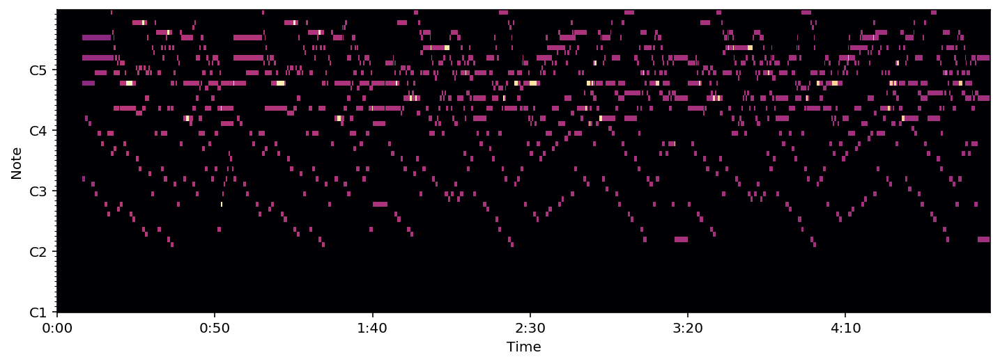

In [39]:
def plot_piano_roll(pm, start_pitch, end_pitch, fs=100):
    # Use librosa's specshow function for displaying the piano roll
    librosa.display.specshow(pm.get_piano_roll(fs)[start_pitch:end_pitch],
                             hop_length=1, sr=fs, x_axis='time', y_axis='cqt_note',
                             fmin=pretty_midi.note_number_to_hz(start_pitch))

plt.figure(figsize=(12, 4))
plot_piano_roll(midi_pretty_format, 24, 84)

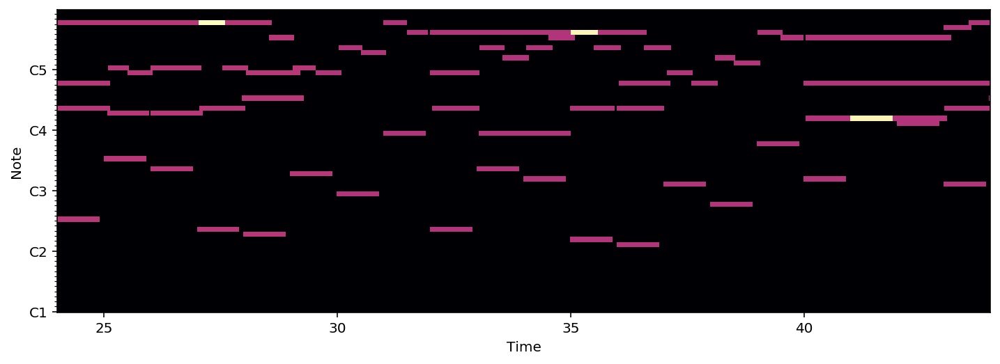

In [41]:
# zooming in to a 20 second frame
plt.figure(figsize=(12, 4))
plot_piano_roll(midi_pretty_format, 24, 84)
ymin, ymax = plt.ylim()
plt.xlim(24,44);

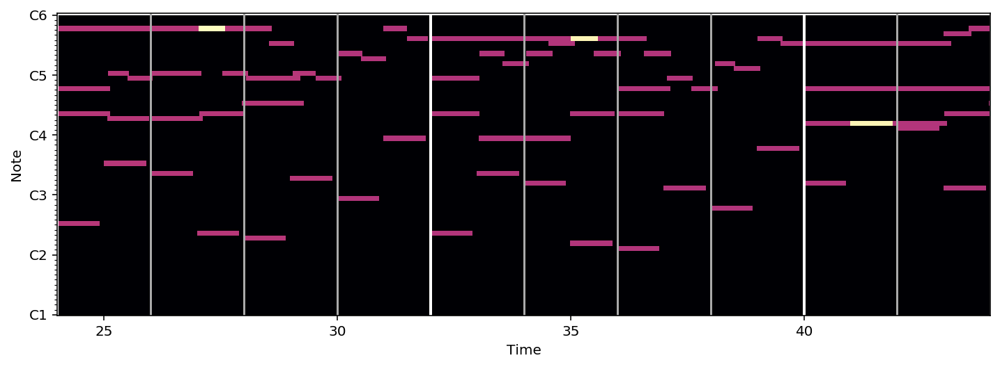

In [42]:
# Get and downbeat times
beats = midi_pretty_format.get_beats()
downbeats = midi_pretty_format.get_downbeats()
# Plot piano roll
plt.figure(figsize=(12, 4))
plot_piano_roll(midi_pretty_format, 24, 84)
ymin, ymax = plt.ylim()
# Plot beats as grey lines, downbeats as white lines
mir_eval.display.events(beats, base=ymin, height=ymax, color='#AAAAAA')
mir_eval.display.events(downbeats, base=ymin, height=ymax, color='#FFFFFF', lw=2)
# 20 seconds for clarity
plt.xlim(24, 44);

In [44]:
bach = converter.parse("/Volumes/S_4/Music_Box/Scraped_midi_data/bach/midi_files/air.mid")

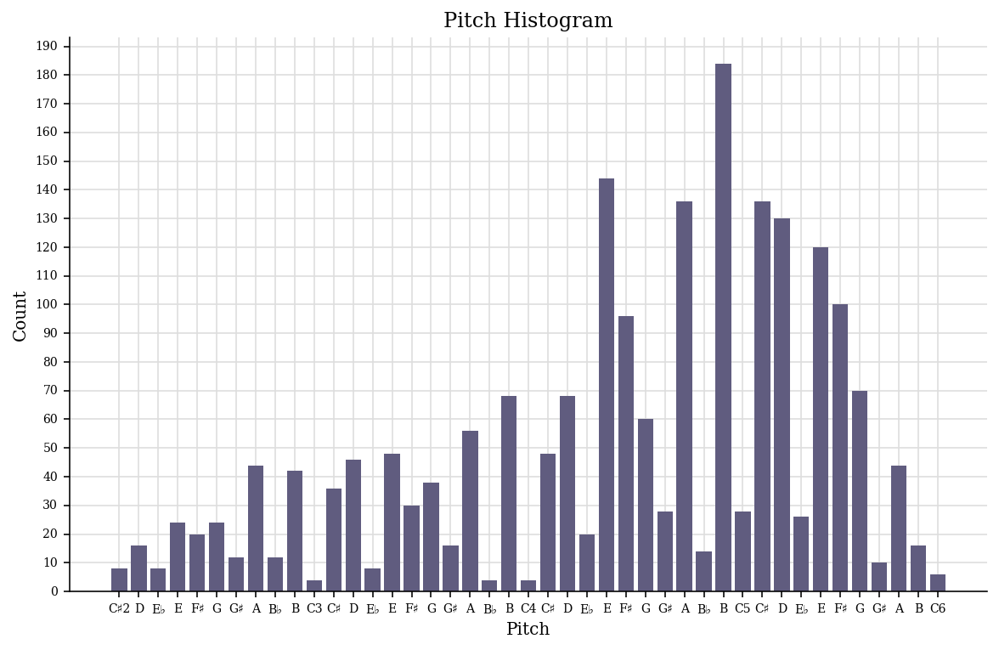

In [45]:
bach.plot('histogram', 'pitch')

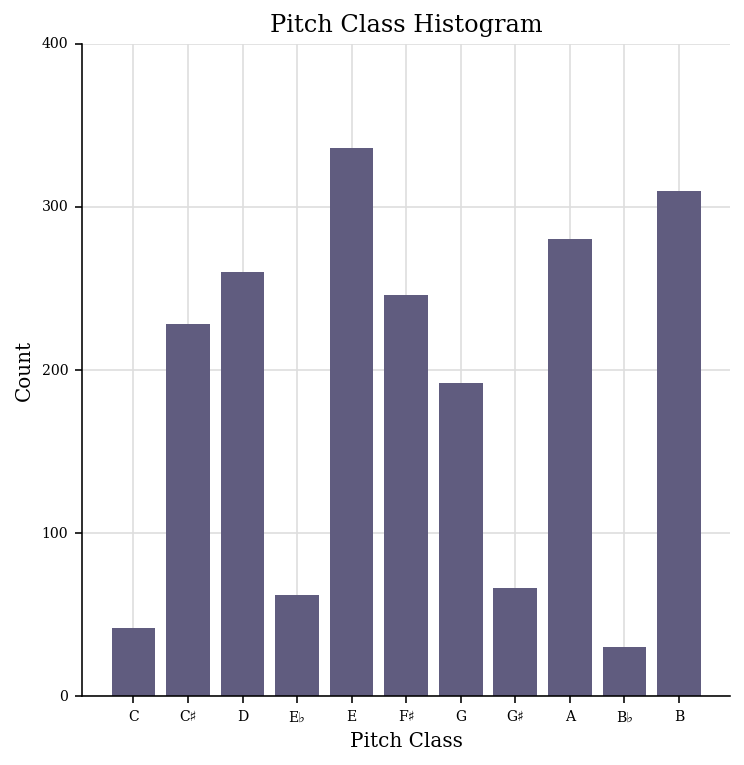

In [46]:
bach.plot('histogram', 'pitchClass')

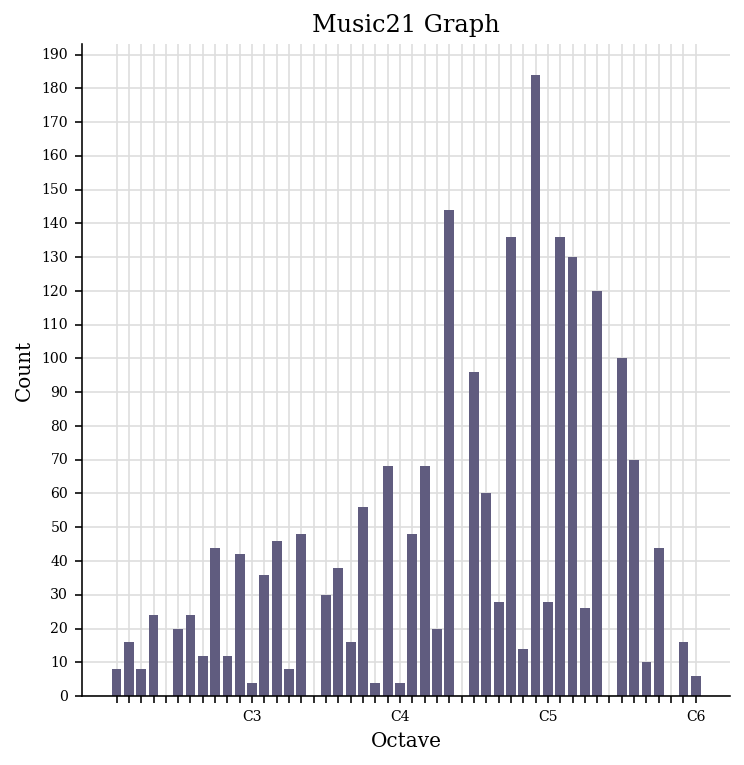

In [48]:
bach.plot('histogram', 'octave', xHideUnused=False, yAxisLabel='Number of Pitches')

In [50]:
bach.analyze('key')

<music21.key.Key of D major>

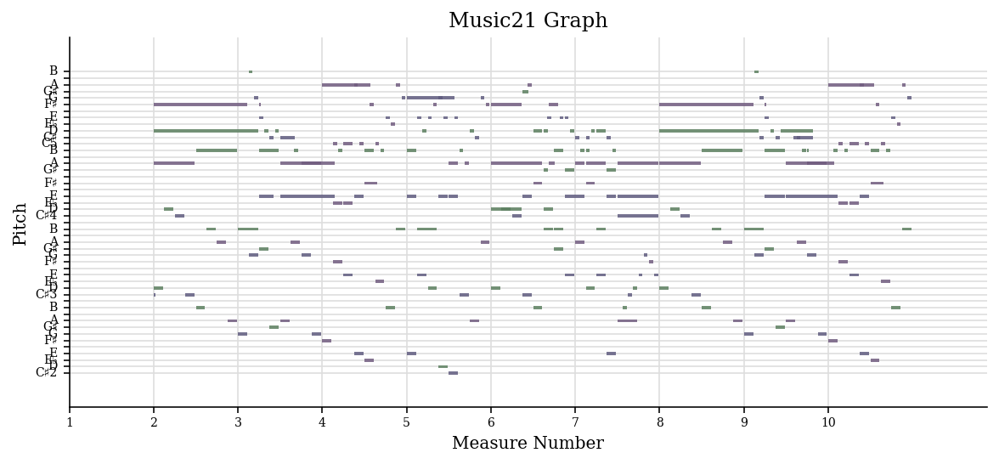

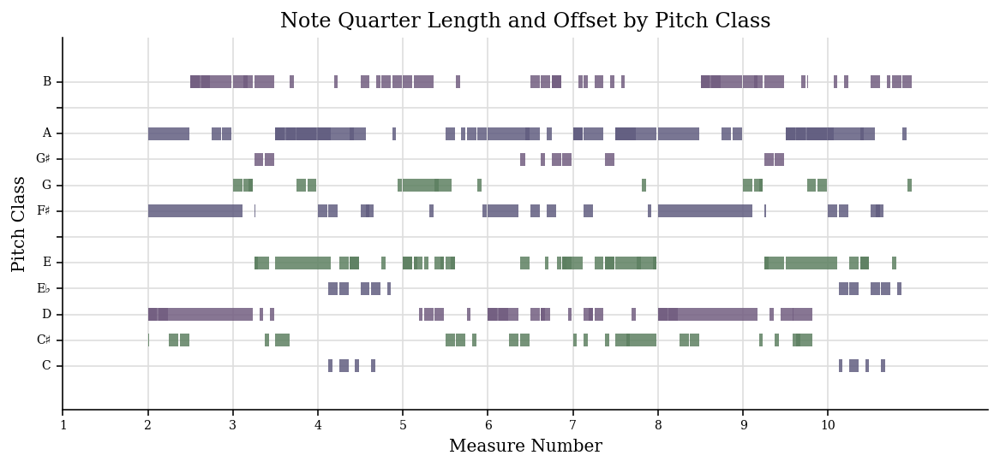

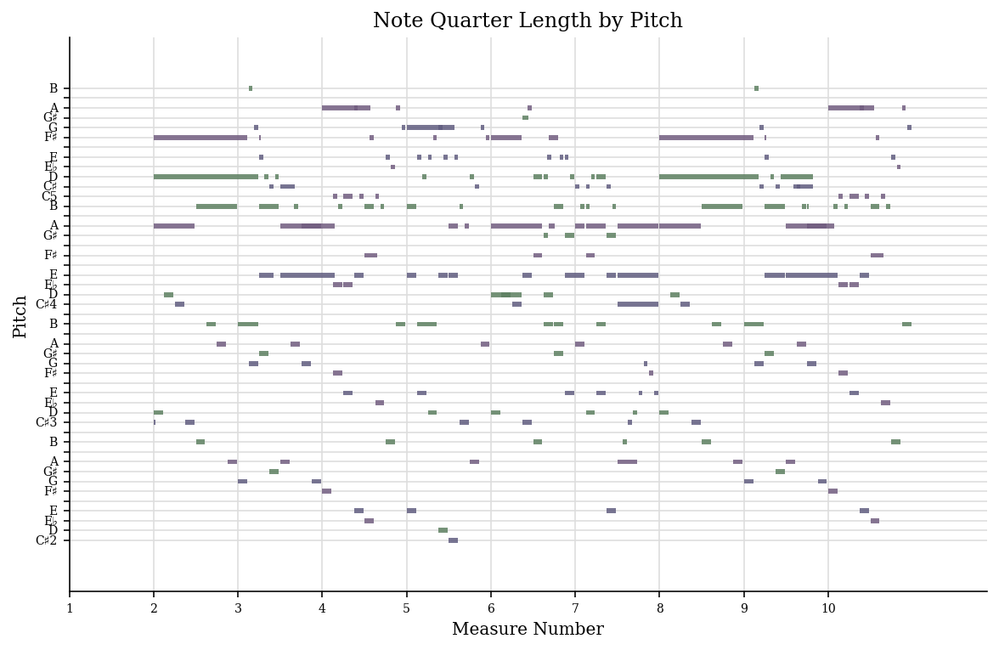

In [51]:
bach.measures(1,10).plot('horizontalbar')

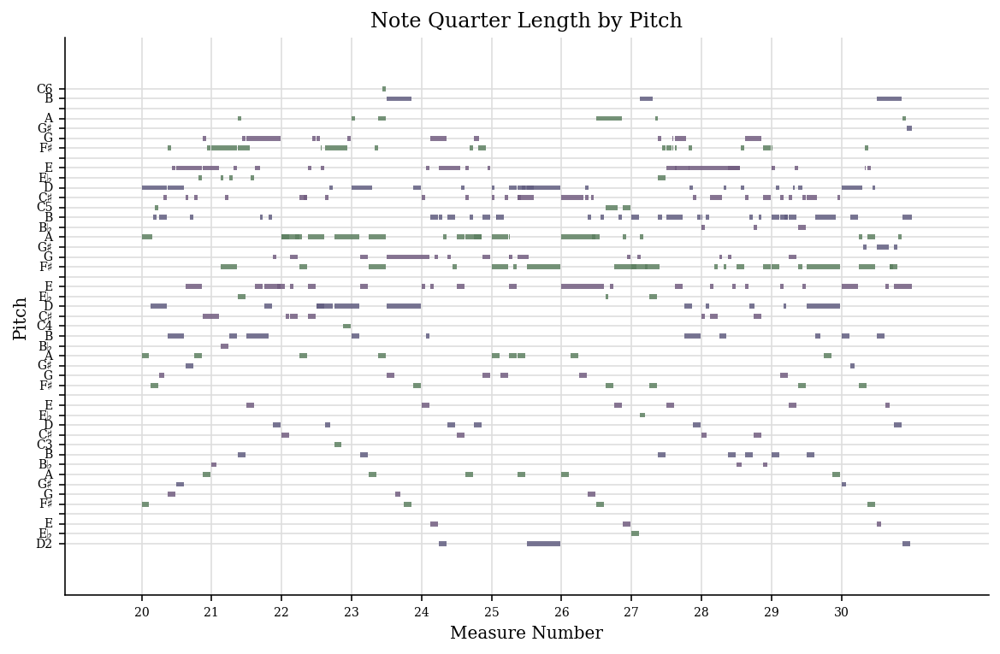

In [52]:
bach.measures(20,30).plot(dpi = 400)

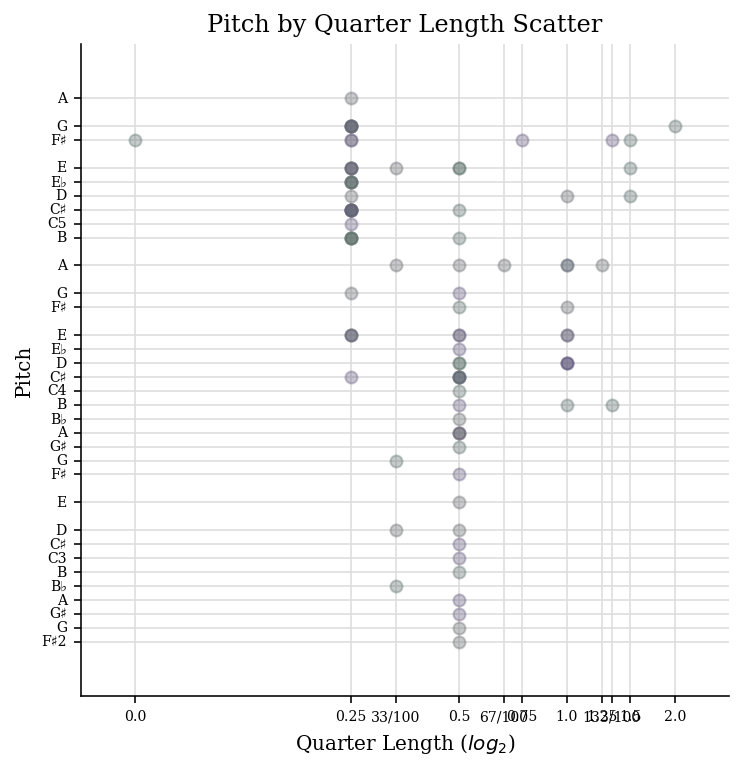

In [53]:
bach.measures(20,22).plot('scatter', 'quarterLength', 'pitch')

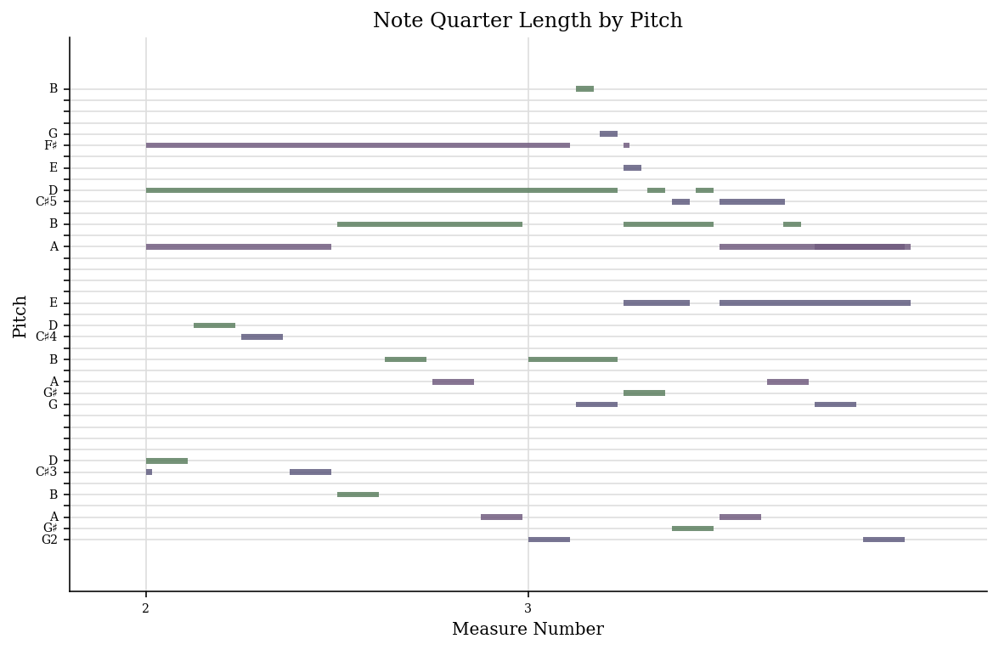

In [54]:
bach.measures(2,3).plot('pianoroll')

Parsing the midi into two categories: 
1. pitch
2. chords

Pitches will be displayed as single letters and a number indicateing pitch and ocatve.
Chords will be displayed as digits with a period between them indicated the pitches in the chord.

We are not considering duration or rhythm. We are focusing on the sequence of the pitches.

In [20]:
for i,file in enumerate(glob.glob("midi_files/*.mid")):
    print(file)

midi_files/bjsair.mid
midi_files/bjsbb21.mid
midi_files/bjsbmm01.mid
midi_files/bjsbmm02.mid
midi_files/bjsbmm03.mid
midi_files/bjsbmm04.mid
midi_files/bjsbmm05.mid
midi_files/bjsbmm06.mid
midi_files/bjsbmm07.mid
midi_files/bjsbmm08.mid
midi_files/bjsbmm09.mid
midi_files/bjsbmm10.mid
midi_files/bjsbmm11.mid
midi_files/bjsbmm12.mid
midi_files/bjsbmm13.mid
midi_files/bjsbmm14.mid
midi_files/bjsbmm15.mid
midi_files/bjsbmm16.mid
midi_files/bjsbmm17.mid
midi_files/bjsbmm18.mid
midi_files/bjsbmm19.mid
midi_files/bjsbmm20.mid
midi_files/bjsbmm21.mid
midi_files/bjsbmm22.mid
midi_files/bjsbmm23.mid
midi_files/bjsfanam.mid
midi_files/bjsgig.mid
midi_files/bjss6a.mid
midi_files/bjss6l.mid
midi_files/bjss6v.mid
midi_files/blute.mid
midi_files/brand3.mid
midi_files/brand5.mid
midi_files/brand22.mid
midi_files/brand23.mid
midi_files/brand41s.mid
midi_files/brand42s.mid
midi_files/brand43s.mid
midi_files/brand61.mid
midi_files/brand62.mid
midi_files/brand63.mid
midi_files/bwv-902.mid
midi_files/bwv15

In [21]:
%time
# create an empty list to hold all instances of note or chord
notes = []
# go through 'midi_files' 
# index midi file and parse through each file
for i,file in enumerate(glob.glob("midi_files/*.mid")):
    print(file)
    midi = converter.parse(file)
    print('\r', 'Parsing file ', i, " ")
#   flatten the notes (make sure each file has only one insturment) 
    notes_to_parse = midi.flat.notes
#   sift through whether each element is a pitch  
    for element in notes_to_parse:
        if isinstance(element, note.Note):
            notes.append(str(element.pitch))
#   or if it is a chord (reduce to pitch_set)
        elif isinstance(element, chord.Chord):
            notes.append('.'.join(str(n) for n in element.normalOrder))
        print(element)
# save as file 'notes' in order to call
with open('notes', 'wb') as filepath:
    pickle.dump(notes, filepath)

CPU times: user 2 µs, sys: 0 ns, total: 2 µs
Wall time: 6.2 µs
midi_files/bjsair.mid
 Parsing file  0  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.chord.Chord F#4 A4 D4>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord D4 B3>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.

<music21.chord.Chord B4 D4>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music2

<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord E4 C#5>
<music21.note.Note B>
<music21.chord.Chord E4 C#5>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.not

<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.chord.Chord C4 C2>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<mus

<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note C>
<music21.chord.Chord F3 F4>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.chord.Chord A3 F4>
<music21.chord.Chord A3 F4>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F>
<music21.chord.Chord F3 F4>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music2

<music21.note.Note F>
<music21.chord.Chord G4 E3>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note B>
<music21.chord.Chord B-4 E3>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note C>
<music21.cho

<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note F>
<music21.chord.Chord D3 D4>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.chord.Chord C4 C3>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note D>
<music21.chord.Chord D3 D4>
<music21.note.Note F>
<music21.note.Note C>
<music21.chord.Chord E3 E4>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.chord.Chord E3 E4>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.chord.Chord F3 F4>
<music21.note.Note

 Parsing file  2  
<music21.chord.Chord D5 B4>
<music21.note.Note B>
<music21.chord.Chord D5 B4>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord D5 B4>
<music21.note.Note B>
<music21.chord.Chord D5 B4>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C#

<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note C#>
<music21.chord.Chord B4 D4>
<music21.note.Note B>
<music21.chord.Chord B4 D4>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.chord.Chord G4 E4>
<music21.chord.Chord G4 E4>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B->
<music21.chord.Chord F#4 D4>
<music21.chord.Chord F#4 D4>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E>
<music21.chord.Chor

<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.chord.Chord B-4 F#4>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.chord.Chord B4 F#4>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note

<music21.chord.Chord F#5 E-5>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.chord.Chord G#5 G#4>
<music21.note.Note E>
<music21.chord.Chord G#5 G#4>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.chord.Chord A5 F#4>
<music21.note.Note E->
<music21.chord.Chord A5 C4>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E->
<music21.chord.Chord G#5 G#4>
<music21.note.Note E>
<music21.chord.Chord G#5 C#4>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note E>
<

<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B>
<music

<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<mu

<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord A4 F#4>
<music21.note.Note F#>
<music21.chord.Chord A4 F#4>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.No

<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note A>
<music21.chord.Chord E5 G4>
<music21.note.Note E>
<music21.chord.Chord E5 G4>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.chord.Chord A4 C4>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note G#>
<music21.chord.Chord G#4 B3>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.chord.Chord E4 G#4>
<music21.note.Note D>
<music21.chord.Chord E4 G#4>
<music21.note.Note E>
<music21.note.Note G#>
<music2

<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note F#>
<music21.chord.Chord G#5 E5>
<music21.note.Note E>
<music21.chord.Chord G#5 E5>
<music2

 Parsing file  3  
<music21.note.Note D>
<music21.chord.Chord F#4 A4>
<music21.note.Note D>
<music21.chord.Chord F#3 A3 D3>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.chord.Chord A4 B4>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord G4 D5>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note A>
<

<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.chord.Chord D4 A4>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.chord.Chord F#4 B4>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G#>
<music21.chord.Chord D4 F#4>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C#>
<music21.chord.Chord

<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note D>
<music21.chord.Chord A4 A2>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.chord.Chord E4 F#4>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E->
<music21.chord.Chord B3 E-4 F#4>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.chord.Chord B3 F4 G#4>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note B>
<music

<music21.chord.Chord C#4 E4 A4 A2>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.chord.Chord C#4 E4 G4>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.chord.Chord D4 F#4>
<music21.note.

 Parsing file  4  
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.

<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.No

<music21.chord.Chord G3 B3>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord E4 E5>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.chord.Chord F#4 D5>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord G4 C#5>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.

<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.chord.Chord F#4 C#5>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.

 Parsing file  5  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<mu

<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note B>
<music21.chord.Chord A5 E5 A4>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.no

<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.chord.Chord G5 A4>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.chord.Chord F#5 A4>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<m

<music21.chord.Chord B4 E-4>
<music21.chord.Chord B4 E-4>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord B4 E-4>
<music21.chord.Chord E-5 B4>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.chord.Chord E-5 B4>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.

<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E->
<music21.chord.Chord F#5 B4>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F#>
<music21.chord.Chord E5 B4>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord E5 B4>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord A5 E5>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.chord.Chord A5 E

<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Not

<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note B>
<music21.chord.Chord B4 G#4>
<music21.chord.Chord E4 A4>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.chord.Chord E4 A4>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<

 Parsing file  6  
<music21.note.Note E>
<music21.note.Note A>
<music21.chord.Chord C#4 E4>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C#>
<music21.chord.Chord A3 E4 A4>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note E>
<music21.chord.Chord B3 E4 G#4>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.chord.Chord E4 A4>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note B>
<music21.chord.Chord D4 G#4>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.chord.Chord C#4 E4 A4>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G#>
<music21.chord.Cho

<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note B>
<music21.chord.Chord B3 E-4>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note E>
<music21.chord.Chord G#3 B3 E4>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G#>
<music21.chord.Chord E3 G#3 B3>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B>
<music21.chord.Chord D3 F#3 B3>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note B->

 Parsing file  7  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C#

<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Not

<music21.note.Note D>
<music21.note.Note D>
midi_files/bjsbmm07.mid
 Parsing file  8  
<music21.note.Note G>
<music21.chord.Chord B3 D4 G4>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note D>
<music21.chord.Chord G3 D4>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord A3 D4 F#4>
<music21.note.Note C>
<music21.note.Note C>
<music21.chord.Chord G3 D4 G4>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C>
<music21.chord.Chord C4 F#4>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord B3 D4 G4>
<music21.note.Note G>
<music21.note.Note G>
<m

<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.chord.Chord D4 A4>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.chord.Chord G4 B4>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.chord.Chord F#4 A4>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E>
<mus

 Parsing file  9  
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.chord.Chord B3 F#4 B4 D3>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord E4 G4 B4 E3>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.chord.Chord A3 C4 E4>
<music21.chord.Chord G4 A2>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.N

<music21.chord.Chord D6 B5>
<music21.chord.Chord D6 B5>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.chord.Chord B3 D4>
<music21.chord.Chord B5 G#5>
<music21.chord.Chord B5 G#5>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.chord.Chord C#6 A5>
<music21.chord.Chord C#6 A5>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.chord.Chord A3 C#4>
<music21.chord.Chord A5 F#5>
<music21.chord.Chord A5 F#5>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.chord.Chord B5 G5>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.n

 Parsing file  10  
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord F#4 B4>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.chord.Chord E4 B-4>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.chord.Chord D4 F#4 B4 B3>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note B->
<music21.chord.Chord C#4 F#4 B-3>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note F#>
<music21.chord.Chord B-3 E4 F#3>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G#>
<music21.chord.Chord B3 D4 G#3>
<music21.note.Note B->

<music21.note.Note A>
<music21.chord.Chord A3 C#4 F#3>
<music21.note.Note B>
<music21.chord.Chord A3 F#4 B2>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note F>
<music21.chord.Chord C#4 F4>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.chord.Chord A3 C#4 F#4 F#2>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.chord.Chord C#4 F#4 A3>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note

<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.chord.Chord E4 G4 C#5>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.chord.Chord D4 F#4 B4 F#3>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note B->
<music21.chord.Chord E4 G4 B4>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.chord.Chord D4 F#4 B4>
<music21.note.Note F

<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music

<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.n

 Parsing file  12  
<music21.note.Note F#>
<music21.chord.Chord F#3 D4>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D

<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.

<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note G

<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.chord.Chord C#5 A4>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.chord.Chord E5 C#5>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.chord.Chord A5 E5>
<music21.note.Note C#>
<

<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.No

<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G#>
<music21.chord.Chord D6 G#5 D5>
<music21.note.Note D>
<music21.chord.Chord B5 G#5>
<music21.note.Note B>
<mu

 Parsing file  13  
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note

<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.No

 Parsing file  14  
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.chord.Chord E5 C#5>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.chord.Chord C#5 A4>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.chord.Chord A4 E4>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<mu

<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord C#5 G4>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.chord.Chord E-5 A4>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.no

<music21.chord.Chord G5 E5>
<music21.note.Note B>
<music21.chord.Chord A5 F#5>
<music21.note.Note C>
<music21.note.Note A>
<music21.chord.Chord D5 F#4>
<music21.chord.Chord E5 G4>
<music21.note.Note D>
<music21.chord.Chord F#5 A4>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.N

 Parsing file  15  
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.not

<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music

<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21

 Parsing file  16  
<music21.note.Note B>
<music21.chord.Chord F#3 B3 D4>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord G3 B3 E4>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.chord.Chord B-3 C#4 E4 G4>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B>
<music21.no

<music21.chord.Chord B4 E-5 F#5>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.chord.Chord B4 E-5 F#5 A5>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note C>
<music21.chord.Chord B4 E5 G#5>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note A>
<music21.chord.Chord C5 E5 A5>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.chord.Chord C5 E5 G5 C6>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.no

 Parsing file  17  
<music21.chord.Chord A4 F#4 D4>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord A4 F#4>
<music21.chord.Chord D5 A4 D4>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.chord.Chord D5 A4>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.N

<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G#>
<music21.chord.Chord F#4 E-4>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.chord.Chord G#4 E4>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord A4 F#4>
<music21.chord.Chord B4 G#4>
<music21.note.Note E>
<music21.note.Note B>
<music21.not

<music21.chord.Chord G5 E5>
<music21.chord.Chord G5 E5>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord G5 E5>
<music21.chord.Chord F#5 D5>
<music21.chord.Chord F#5 D5>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord F#5 D5>
<music21.chord.Chord G5 E5>
<music21.chord.Chord G5 E5>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.chord.Chord F#5 D5>
<music21.chord.Chord F#5 D5>
<music21.note.Note F#>
<music21.chord.Chord E5 C#5>
<music21.chord.Chord E5 C#5>
<music21.note.Note E>
<music21.chord.Chord F#5 D5>
<music21.chord.Chord F#5 D5>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note

<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note C#>
<musi

<music21.chord.Chord G5 E5>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.chord.Chord A5 F#5>
<music21.chord.Chord G5 E5>
<music21.chord.Chord A5 F#5>
<music21.chord.Chord A5 F#5>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note F#>
<music21.chord.Chord A5 F#5>
<music21.chord.Chord B5 G5>
<music21.chord.Chord B5 G5>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord A5 F#5>
<music21.chord.Chord A5 F#5>
<music21.note.Note F#>
<music21.note.Note A>
<music21.chord.Chord G5 E5>
<music21.chord.Chord G5 E5>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.chord.Chord A5 F#5>
<m

<music21.chord.Chord F#5 A4>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord D5 B4>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B->
<music21.chord.Chord E5 B-4>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord D5 B4>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.chord.Chord B4 D5>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.chord.Chord D5 F#4>
<music21.note.Note B>
<m

 Parsing file  18  
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.chord.Chord E4 A4 C#3>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note B>
<music21.chord.Chord D4 G#4 B4>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.chord.Chord E4 A4 C#5>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.chord.Chord F#4 B4 D5 D3>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.chord.Chord G#4 B4>
<music21.note.Note E>
<music21.note.Note 

<music21.note.Note E>
<music21.chord.Chord A4 C#5 A3>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.chord.Chord G#4 B4>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.chord.Chord F#4 A4 F#3>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.chord.Chord C#4 A4>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note F#>
<music21.chord.Chord B3 A4 E-3>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord B3 G#4>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord E-4 F#4>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G#>

<music21.chord.Chord B4 D5>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G#>
<music21.chord.Chord G#4 D5 E5>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.chord.Chord A4 C#5 E5>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.chord.Chord A4 C#5 D3>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.chord.Chord A4 C#5 E3>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note

 Parsing file  19  
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.not

<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note

<music21.note.Note D>
<music21.chord.Chord F#5 D5>
<music21.chord.Chord G5 E5>
<music21.chord.Chord G5 E5>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B>
<music21.chord.Chord G5 E5>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.chord.Chord A5 C#5>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.chord.Chord A5 C#5>
<music21.chord.Chord G5 E5>
<music21.chord.Chord G5 E5>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord G5 E5>
<music21.chord.Chord F#5 D5>
<music21.note.Note A>
<music21.note.Note D>
<music21.chord.Chord F#5 D5>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.chord.Chord F#5 D5>
<music21.chord.Chord E5 C#5>
<music21.chord.Chord E5 C#5>
<music21.note.Note E>
<music21.note.Note C#>
<m

<music21.chord.Chord D5 A4>
<music21.chord.Chord F#4 D4>
<music21.chord.Chord A4 F#4>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.chord.Chord A4 F#4>
<music21.chord.Chord A4 F#4>
<music21.chord.Chord D5 A4>
<music21.note.Note D>
<music21.chord.Chord D5 A4>
<music21.chord.Chord D5 A4>
<music21.chord.Chord F#5 D5>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.chord.Chord F#5 D5>
<music21.note.Note D>
<music21.chord.Chord A4 F#4>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.chord.Chord A4 F#4>
<music21.note.Note D>
<music21.chord.Chord D5 A4>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.chord.Chord D5 A4>
<music21.note.Note D>
<music21.chord.Chord F#5 D5>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.No

<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.chord.Chord A4 A4>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.chord.Chord A4 A4>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.no

<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord D5 F#4>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.chord.Chord E5 A4>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.chord.Chord C#5 G4>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord D5 F#4>
<music21.chord.Chord E5 A4>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.n

<music21.chord.Chord D5 B4>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord B5 F#5 D5>
<music21.chord.Chord E5 C#5>
<music21.note.Note C#>
<music21.chord.Chord F#5 D5>
<music21.note.Note B>
<music21.chord.Chord F#5 D5 B4>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord B5 F#5 D5>
<music21.chord.Chord E5 C#5>
<music21.note.Note C#>
<music21.chord.Chord F#5 D5>
<music21.note.Note B>
<music21.chord.Chord F#5 D5 B4>
<music21.note.Note C#>
<music21.note.Note B->
<music21.chord.Chord F#5 C#5>
<music21.note.Note F#>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B->
<music21.note.Note B->
<music21.chord.Chord C#6 F#5 C#5>
<music21.chord.Chord G5 E5 B4>
<music21.note.Note B->
<music21.chord.Chord F#5 D5 B-4>
<music21.note

<music21.note.Note G#>
<music21.note.Note E>
<music21.chord.Chord A4 F#4>
<music21.note.Note D>
<music21.chord.Chord A5 F#5 D5>
<music21.note.Note D>
<music21.chord.Chord D5 A4>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note E>
<music21.chord.Chord A4 F#4>
<music21.note.Note D>
<music21.chord.Chord A5 F#5 D5>
<music21.note.Note G>
<music21.note.Note C#>
<music21.chord.Chord E5 A4>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.chord.Chord B5 G5>
<music21.note.Note D>
<music21.chord.Chord A5 F#5>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.chord.Chord G5 E5>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.chord.Chord F#5 D5>
<music21.note.Note A>
<music21.note

<music21.note.Note F#>
<music21.chord.Chord D5 A3>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.chord.Chord A5 F#5 D5>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.chord.Chord A4 C#5 E5 A3>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord A4 D5 F#5 A3>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>


<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.chord.Chord B4 G4>
<music21.note.Note A>
<music21.note.Note C#>
<music21.chord.Chord C#5 A4>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord D5 B3>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.chord.Chord D5 B4>
<music21.note.Note C#>
<music21.note.Note E>
<music21.chord.Chord E5 C#5>
<music21.note.Note B>
<music21.note.Note C#>
<music21.chord.Chord E5 C#4>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.chord.Chord D5 B4>
<music21.note.Note A>
<music21.note.Note D>
<music21.chord.Chord F#5 D4>
<music21.note.Not

<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<mus

 Parsing file  21  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.

<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.chord.Chord G#5 E5>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord A5 E5>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord F#5 A4>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord E5 B4>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Not

<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.chord.Chord A4 C#5>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord A5 A4>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.chord.Chord A5 F#5>
<music2

<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note

 Parsing file  22  
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord D4 B4>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.chord.Chord E4 G4>
<music21.note.Note E>
<music21.note.Note B->
<music21.chord.Chord C#4 F#4 B-3>
<music21.note.Note G#>
<music21.chord.Chord B3 G#3>
<music21.note.Note B->
<music21.chord.Chord C#4 F#4>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note C#>
<music21.chord.Chord E4 G4>
<music21.note.Note F#>
<music21.chord.Chord B-3 F#4>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.chord.Chord B3 D4>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note B>
<mus

<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note G>
<music21.chord.Chord F#4 A4>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord E4 G4>
<music21.note.Note D>
<music21.note.Note A>
<music21.chord.Chord D4 F#4>
<music21.note.Note A>
<music21.note.Note C#>
<music21.chord.Chord C#4 E4>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.chord.Chord D4 F#4>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord F#4 A4>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<mu

<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note G>
<music21.chord.Chord E4 C#5 G3>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.chord.Chord D4 B4 F#3>
<music21.note.Note E>
<music21.chord.Chord C#4 B-4>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note B->
<music21.chord.Chord C#4 F#4>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B->
<

<music21.chord.Chord D3 F3 A3>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G>
<music21.chord.Chord G2 E-3 B-3>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note A>
<music21.chord.Chord A2 E3 A3>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C#>
<music21.chord.Chord C#3 E3>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.chord.Chord D3 A3>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F>
<music21.chord.Chord F3 A3>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G>
<music21.chord.Chord G3 D4>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord E3 G3 C#4>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F>
<music21.chord.Chord D4 F4>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.chord.Chord D4 F4>
<music21.note.Note A>
<music21.note.N

<music21.note.Note F#>
<music21.chord.Chord F#3 D4>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note F#>
<music21.chord.Chord D3 F#3 D4>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord G3 D4>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note B>
<music21.chord.Chord E-3 G3>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C>
<music21.chord.Chord D3 A3>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F#>
<music21.chord.Chord F#3 A3>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note D>
<music21.chord.Chord G4 D5 B-2 G3>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note A>
<music21.chord.Chord G4 G3>

<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.

<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F

 Parsing file  25  
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note A>
<music21.not

<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<mus

<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note B>
<m

 Parsing file  26  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music

<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#

<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.

<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.No

 Parsing file  27  
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music2

<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>


<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note F#>
<

<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
midi_files/bjss6l.mid
 Parsing file  28  
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>


<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#

 Parsing file  29  
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<mus

<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.no

<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<musi

<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<mu

 Parsing file  30  
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#

<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note

<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<m

<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F

<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.

<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21

<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note 

<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note 

<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music

<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note F#>

<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<musi

<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21

<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note

<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note C>
<mu

<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E-

<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>

<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.n

<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>

<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.n

<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.n

<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<

 Parsing file  32  
<music21.chord.Chord A4 D4 F#4 D5>
<music21.chord.Chord A3 D3 F#3>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note A>


<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note 

<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G#>
<music21.

<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>


<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note

<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note F#>
<musi

<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note

<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.no

<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music2

<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<m

<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note 

 Parsing file  33  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note E>
<music

<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F

 Parsing file  34  
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music2

<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note A>

 Parsing file  35  
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord G3 G5>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord D3 D5>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord G2 G4>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord G3 G5>
<music21.note.Note B>
<music21.note.Note G>
<music2

<music21.note.Note C>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.chord.Chord A2 A4>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord D3 D5>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord B2 B4>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<

<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note F#>
<music21

<music21.note.Note A>
<music21.chord.Chord A2 A4>
<music21.note.Note B>
<music21.chord.Chord B2 B4>
<music21.note.Note A>
<music21.note.Note C>
<music21.chord.Chord C3 C5>
<music21.note.Note C>
<music21.chord.Chord A2 A4>
<music21.note.Note F>
<music21.note.Note D>
<music21.chord.Chord D3 D5>
<music21.note.Note E>
<music21.chord.Chord C3 C5>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B>
<music21.chord.Chord B2 B4>
<music21.note.Note C>
<music21.chord.Chord C3 C5>
<music21.note.Note B>
<music21.note.Note D>
<music21.chord.Chord D3 D5>
<music21.note.Note D>
<music21.chord.Chord B2 B4>
<music21.note.Note G#>
<music21.note.Note E>
<music21.chord.Chord E3 E5>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.chord.Chord F#3 F#5>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G#>

<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord D4 D6>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.chord.Chord D3 D5>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.chord.Chord G2 G4>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.chord.Chord G3 G5>
<music21.note.Note D>
<music21.note.Note E>
<music

<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord E4 E6>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord E4 E6>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord E3 E5>
<music

<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord G3 G5>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note F>
<music21.chord.Chord F3 F5>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord E3 E5>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.

<music21.chord.Chord G2 G3>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord G1 G2>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.chord.Chord C1 C2>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<m

 Parsing file  37  
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.n

<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note 

<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<m

<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C#>
<

<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F#>
<mus

 Parsing file  38  
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.not

<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<m

<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note 

<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->

<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Not

 Parsing file  39  
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.n

<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note

<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note

<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B->
<music21

<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note G>


 Parsing file  42  
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note D>
<music21.chord.Chord B-2 F4>
<music21.chord.Chord B-4 F3>
<music21.note.Note B->
<music21.chord.Chord B-2 F3 F4 D4 B-4>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.chord.Chord D4 B-4 F4 F3 B-2>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note G#>
<music21.chord.Chord B-2 F3 F4 D4 B-4>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord G3 B-3 E-3 B-4 F4>
<music21.note.Note E->
<music21.note.Note E->
<music21.chord.Chord E-3 B-3 B-4 E-4 G4>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.chord.Chord C4 C3 C5 G4 E-4>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F#>
<music21.chord.Chord G3 C3 E-4 C5 F#4>
<music21.note.Note C>
<music21.note.Note

<music21.chord.Chord C3 F2 C5 F4 A4>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord F2 F3 A4 D5 F4>
<music21.note.Note F>
<music21.note.Note B->
<music21.chord.Chord C3 F2 B-4 F4 D5>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B->
<music21.chord.Chord G4 F2 F3 E5 B-4>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord C3 B-4 E5 G4 F2>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.chord.Chord F2 F3>
<music21.chord.Chord B-3 F4 B-4>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note F>
<music21.chord.Chord A3 F4 A4>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.n

 Parsing file  43  
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note B>
<music21.not

 Parsing file  44  
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.chord.Chord C4 C5>
<music21.chord.Chord B3 D5>
<music21.chord.Chord C4 E-5>
<music21.chord.Chord D4 F5>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note 

 Parsing file  45  
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.chord.Chord F#4 D3>
<music21.chord.Chord D4 E3>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C#>
<music21.chord.Chord B4 F#3>
<music21.chord.Chord A4 E3>
<music21.chord.Chord C#5 F#3>
<music21.chord.Chord D5 D3>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<musi

 Parsing file  46  
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<m

 Parsing file  47  
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note C>
<music21.chord.Chord B-3 F4>
<music21.chord.Chord C4 E-4>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G>
<

 Parsing file  48  
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note

 Parsing file  49  
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord A3 B4>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.chord.Chord E3 F#5>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord F#4 A5>
<music21.chord.Chord E4 G5>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.No

 Parsing file  50  
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music2

 Parsing file  51  
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.chord.Chord D3 F5>
<music21.chord.Chord E3 G5>
<music21.chord.Chord F3 G#5>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G#>
<music21.chord.Chord 

 Parsing file  52  
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.chord.Chord F#3 F#5>
<music21.chord.Chord A3 D5>
<music21.chord.Chord F#3 A5>
<music21.chord.Chord D3 F#5>
<music21.chord.Chord A3 D5>
<music21.chord.Chord F#3 A5>
<music21.chord.Chord D3 F#5>
<music21.chord.Chord C4 D5>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.chord.Chord G3 B4>
<music21.chord.Chord D4 F5>
<music21.chord.Chord B3 D5>
<music21.chord.Chord G3 B4>
<music21.chord.Chord D4 F5>
<music21.chord.Chord B3 D5>
<music21.chord.Chord G3 B4>
<music21.chord.Chord C4 E5>
<music21.chord.Chord E4 C5>
<music21.chord.Chord C4 A4>
<music21.chord.Chord A3 F#4>
<music21.chord.Chord C

 Parsing file  53  
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G>
<music21.chord.Chord F#3 A4>
<music21.chord.Chord G3 G4>
<music21.chord.Chord A3 F#4>
<music21.chord.Chord G3 E4>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note A>
<music21.chord.Chord E3 G4>
<music21.chord.Chord F3 F4>
<music21.chord.Chord G3 E4>
<music21.chord.Chord F3 D4>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note

 Parsing file  54  
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.No

 Parsing file  55  
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.

 Parsing file  56  
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note

 Parsing file  57  
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.chord.Chord F#2 E4>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.n

 Parsing file  58  
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.no

 Parsing file  59  
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.chord.Chord C4 E-5>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G>
<music21.chord.Chord F3 G#5>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G#>
<music21.chord.Chord A3 G5>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note E->
<music21.chord.Chord G3 D5>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note 

 Parsing file  60  
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.chord.Chord F#3 C5>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.chord.Chord E3 B4>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.chord.Chord D3 A4>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<mus

 Parsing file  61  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note D>
<music21.chord.Chord F3 A4>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E>
<music21.chord.Chord C#4 A4>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.chord.Chord A4 F5>
<music21.chord.Chord G#4 E5>
<music21.chord.Chord A4 D5>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.chord.Chord B4 G#5>
<music21.chord.Chord A4 F#5>
<music21.chord.Chord B4 G#5>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>

 Parsing file  62  
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.chord.Chord C5 F4>
<music21.chord.Chord C#5 B-4>
<music21.note.Note G>
<music21.chord.Chord E-5 C5>
<music21.chord.Chord C5 G#4>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G#>
<music21.chord.Chord C5 G4>
<music21.chord.Chord F5 G#4>
<music21.note.Note F>
<music21.chord.Chord G5 B-4>
<music21.chord.Chord E-5 G4>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note C>
<music21.chord.Chord D5 G4>
<music21.chord.Chord E-5 C5>
<music21.note.Note A>
<music21.chord.Chord F5 D5>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note

 Parsing file  63  
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.chord.Chord F#4 B-4>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note F#>
<

 Parsing file  64  
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord F#5 B3>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note A>
<music21.chord.Chord G5 B3>
<music21.chord.Chord F#5 A3>
<music21.chord.Chord E5 C4>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.chord.Chord D5 B4>
<music21.chord.Chord E5 C#5 A3>
<music21.chord.Chord F#5 D5>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.chord.Chord E5 C#5>
<music21.chord.Chord G5 E5>
<music21.chord.Chord F#5 D5 F#3>
<music21.chord.Chord E5 C#5 G3>
<music21.chord.Chord D5 B4 E3>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.chord.Chord F#5 A4>
<music21.n

 Parsing file  65  
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note B->
<music21.chord.Chord A3 F5>
<music21.note.Note C>
<music21.chord.Chord G3 E5>
<music21.chord.Chord F3 A5>
<music21.chord.Chord E3 G5>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F>
<music21.chord.Chord G3 E5>
<music21.chord.Chord F3 D5>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.chord.Chord C3 C5>
<music21.note.Note E>
<music21.note.Note F>
<music21.chord.Chord C4 D5>
<music21.note.Note B->
<music21.chord.Chord A3 E5>
<music21.note.Note D

 Parsing file  66  
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C#>
<music21.chord.Chord C3 C5>
<music21.chord.Chord C2 B-4>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note B>
<music

 Parsing file  67  
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.chord.Chord C#4 A4>
<music21.chord.Chord D4 B4>
<music21.chord.Chord E4 C#5>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.

 Parsing file  68  
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.chord.Chord E-3 G5>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.chord.Chord G3 A4>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.chord.Chord F#4 D5>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B->
<music21.chord.Chord C4 E-5>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B->
<music21.chord.Chord D3 F#4 C5>
<music21.note.Note G>
<music21.chord.Chord G4 B-4>
<music21.note.Note D>
<music21.note.Note B->


 Parsing file  69  
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note

 Parsing file  70  
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.chord.Chord G#3 B4>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.chord.Chord F3 D5>
<music21.chord.Chord D3 C5>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.chord.Chord A3 C5>
<music21.chord.Chord B3 D5>
<music21.chord.Chord C4 E5>
<music21.chord.Chord A3 F#5>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.chord.Chord E-4 F#4>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<

 Parsing file  71  
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord A3 F4>
<music21.chord.Chord G3 G4>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E->
<music21.chord.Chord E-3 F4>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F>
<mus

 Parsing file  72  
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.chord.Chord B3 F#4>
<music21.chord.Chord C#4 F#4>
<music21.chord.Chord D4 B4>
<music21.chord.Chord C#4 F#4>
<music21.chord.Chord B3 F#4>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.chord.Chord B3 F#4>
<music21.chord.Chord C#4 F#4>
<music21.chord.Chord B3 C#5>
<music21.chord.Chord C#4 F#4>
<music21.chord.Chord B-3 F#4>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.

 Parsing file  73  
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E

 Parsing file  74  
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.

<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.chord.Chord A3 F4>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.chord.Chord D3 B-4>
<music21.chord.Chord C3 A4>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note C>
<music2

 Parsing file  76  
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note B>
<music21.

 Parsing file  77  
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.No

<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.chord.Chord B-4 F#3>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.chord.Chord B4 D3>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note C#>
<music21.chord.Chord B5 B2>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F

<music21.note.Note E>
<music21.note.Note F#>
<music21.chord.Chord E5 B-3>
<music21.note.Note C#>
<music21.chord.Chord F#5 C#4>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.chord.Chord C#5 A3>
<music21.chord.Chord B4 G3>
<music21.chord.Chord B-4 F#3>
<music21.chord.Chord B4 G3>
<music21.chord.Chord C#5 E3>
<music21.chord.Chord D5 B-4>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.chord.Chord B4 F#2>
<music21.chord.Chord D4 B4 F#4>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.no

<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.chord.Chord B4 B3>
<music21.chord.Chord C#5 A3>
<music21.chord.Chord A4 C#4>
<music21.chord.Chord B4 B3>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E>
<music21.chord.Chord G5 A3>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note D>
<music21.chord.Chord F#5 A3>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<mu

<music21.chord.Chord G2 E5>
<music21.chord.Chord A2 F#5>
<music21.chord.Chord B2 G5>
<music21.chord.Chord C#3 A5>
<music21.chord.Chord D3 G#5>
<music21.chord.Chord E3 A5>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.chord.Chord G#2 B5>
<music21.chord.Chord E2 A5>
<music21.chord.Chord F#2 G#5>
<music21.chord.Chord G#2 F#5>
<music21.chord.Chord A2 E5>
<music21.chord.Chord B2 D5>
<music21.chord.Chord A2 C#5>
<music21.chord.Chord B2 B4>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.chord.Chord C#3 E5>
<music21.chord.Chord B2 D5>
<music21

<music21.chord.Chord G3 F#4>
<music21.chord.Chord C4 G4>
<music21.chord.Chord A3 A4>
<music21.chord.Chord B3 G4>
<music21.chord.Chord G3 E4>
<music21.chord.Chord A3 F#4>
<music21.chord.Chord F#3 E-4>
<music21.chord.Chord G3 E4>
<music21.chord.Chord F#3 F#4>
<music21.chord.Chord E3 G4>
<music21.chord.Chord G3 E4>
<music21.chord.Chord B2 E-4>
<music21.chord.Chord E3 E4>
<music21.chord.Chord B3 G4>
<music21.chord.Chord G3 E4>
<music21.chord.Chord A3 F#4>
<music21.chord.Chord F#3 E-4>
<music21.chord.Chord G3 E4>
<music21.chord.Chord E3 C#4>
<music21.chord.Chord F#3 E-4>
<music21.chord.Chord E-3 C5>
<music21.chord.Chord E3 B4>
<music21.chord.Chord E-3 A4>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music2

<music21.chord.Chord C5 A3>
<music21.chord.Chord D5 B3>
<music21.chord.Chord C5 A3>
<music21.chord.Chord B4 G3>
<music21.chord.Chord C5 A3>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.chord.Chord F#4 D3>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.chord.Chord D5 A3>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.no

<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E->
<music21.chord.Chord E5 G3>
<music21.chord.Chord F#5 A3>
<music21.chord.Chord B4 B3>
<music21.chord.Chord E-5 B2>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music21.chord.Chord A4 G#3>
<music21.chord.Chord B4 E3>
<music21.note.Note C>
<musi

<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.chord.Chord G2 D4>
<music21.chord.Chord C3 E4>
<music21.chord.Chord E3 C4>
<music21.chord.Chord G3 E4>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord B2 G4>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.chord.Chord G#2 B4>
<music21.chord.Chord A2 C5>
<music2

<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B->
<music21.chord.Chord G3 G2>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G#>
<music21.chord.Chord F3 F2>
<musi

<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B->
<music21.chord.Chord G2 E-5>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G>
<music21.chord.Chord A3 E-5>
<music21.chord.Chord B-3 D5>
<music21.chord.Chord A3 C5>
<music21.chord.Chord B-3 B-4>
<music21.chord.Chord C4 A4>
<music21.note.Note D>
<

<music21.note.Note D>
<music21.note.Note C#>
<music21.chord.Chord F3 D4>
<music21.chord.Chord E3 E4>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C#>
<music21.chord.Chord D4 A5>
<music21.chord.Chord G3 B-5>
<music21.chord.Chord C#4 A5>
<music21.chord.Chord D4 G5>
<music21.chord.Chord G#3 F5>
<music21.chord.Chord C#4 E5>
<music21.chord.Chord D4 D5>
<music21.chord.Chord A3 C#5>
<music21.chord.Chord C#4 E5>
<music21.chord.Chord D4 A4>
<music21.chord.Chord E4 G4>
<music21.chord.Chord D4 F4>
<music21.chord.Chord C#4 E4>
<music21.chord.Chord D4 F4>
<music21.chord.Chord F3 A4>
<music21.chord.Chord G3 D5>
<music21.chord.Chord A3 E4>
<music21.chord.Chord G3 D5>
<music21.chord.Chord A3 C#5>
<music21.chord.Chord D3 D5>
<music21.chord.Chord F#3 A4>
<music21.chord.Chord A3 F#4>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<musi

 Parsing file  80  
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note A>
<music21.chord.Chord F3 F5>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note B->
<music21.chord.Chord A3 G5>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.chord.Chord B-3 E5>
<music21.chord.Chord C4 F5>
<music21.note.Note A>
<music21.note.Note F>
<mus

<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note B->
<music21.chord.Chord A2 C4>
<music21.note.Note F#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.chord.Chord E3 B-4>
<music21.chord.Chord F#3 A4>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.chord.Chord B-4 G5>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.chord.Chord C4 A5>
<music21.chord.Chord B-3 G5>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note C>
<music21.chord.Chord F5 A

<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note C>
<music21.chord.Chord G4 E5>
<music21.note.Note C>
<music21.chord.Chord A4 F5>
<music21.chord.Chord E5 G4>
<music21.chord.Chord D5 F4>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note A>
<music21.chord.Chord G3 C5>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Not

<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.chord.Chord E3 F5>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.chord.Chord G3 F5>
<music21.chord.Chord C4 E5>
<music21.chord.Chord G3 G5>
<music21.chord.Chord C4 E5>
<music21.chord.Chord E4 C5>
<music21.chord.Chord C4 E5>
<music21.chord.Chord E4 C5>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C>
<music21.chord.Chord C4 D5>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.chord.Chord B4 B5>
<music21.chord.Chord A4 C6>
<music21.chord.Chord G4 D5>
<music21.chord.Chord A4 C6>
<music21.chord.Chord F4 B5>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.note

 Parsing file  81  
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord F#4 E5>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.chord.Chord E4 G5>
<music21.chord.Chord F#4 F#5>
<music21.chord.Chord E4 G5>
<music21.chord.Chord D4 E5>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.chord.Chord B3 C#5>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note G#>
<music21.chord.Chord B-3 F#5>
<music21.chord.Ch

<music21.note.Note G#>
<music21.chord.Chord D3 B4>
<music21.chord.Chord G#2 E4>
<music21.chord.Chord A2 F#4>
<music21.chord.Chord B2 G#4>
<music21.chord.Chord D3 B4>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.chord.Chord E4 C5 A4 E5>
<music21.note.Note B>
<music21.note.Note C>
<music21.chord.Chord E3 E5>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.chord.Chord A2 F5>
<music21.chord.Chord B2 E5>
<music21.chord.Chord C3 F5>
<music21.chord.Chord F3 D5>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.chord.Chord F3 B4>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note B>
<music21.chord.Chord E3 E5>
<music21.chord.Chord F#3 D5>
<music21.chord.Chord G#3 E5>
<music21.chord.Chord E3 B4>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note A>
<music21.n

<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord C#4 A5>
<music21.chord.Chord D3 F#5>
<music21.chord.Chord C#4 B-5>
<music21.chord.Chord D3 B5>
<music21.chord.Chord B3 G5>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C#>
<music21.chord.Chord B3 G5>
<music21.chord.Chord B-3 F#5>
<music21.chord.Chord G#3 E5>
<music21.chord.Chord B-3 F#5>
<music21.chord.Chord C#4 G5>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note E>
<music21.chord.Chord B3 D5>
<music21.chord.Chord B-3 C#5>
<music21.chord.Chord G#3 B4>
<music21.chord.Chord B-3 C#5>
<music21.chord.Chord C#4 E5>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B->
<mus

<music21.note.Note A>
<music21.note.Note G#>
<music21.chord.Chord E3 G#2>
<music21.note.Note F#>
<music21.note.Note E>
<music21.chord.Chord G#2 F3>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F>
<music21.chord.Chord G#2 C#3 E5>
<music21.chord.Chord D3 G#2 F5>
<music21.chord.Chord G#2 E3>
<music21.note.Note D>
<music21.note.Note C#>
<music21.chord.Chord G#2 F3 D5>
<music21.chord.Chord G#2 B4>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.chord.Chord A2 E5>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.chord.Chord D3 F5 D5>
<music21.chord.Chord E3 E5 C5>
<music21.chord.Chord F3 D5 B4>
<music21.chord.Chord D3 A4 C5>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.

<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note A>
<music21.chord.Chord E3 F5>
<music21.note.Note G#>
<music21.note.Note B>
<music21.chord.Chord D4 E5>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note B>
<music21

 Parsing file  82  
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.chord.Chord C#4 G3 E3>
<music21.note.Note G>
<music21.note.Note B->
<music21.chord.Chord D4 A4>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.chord.Chord E4 G3 B-3>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>


<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F>
<

<music21.note.Note E->
<music21.note.Note C>
<music21.chord.Chord B-2 D5>
<music21.chord.Chord C3 E-5>
<music21.chord.Chord A2 F5>
<music21.chord.Chord B-2 G5>
<music21.chord.Chord C3 A5>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.chord.Chord E-4 F5>


<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note A>
<music21.chord.Chord B-4 G3>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord A4 F#3>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.no

<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G

<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note A>
<music21.chord.Chord G3 B-4>
<music21.chord.Chord F3 A4>
<music21.chord.Chord E3 G4>
<music21.chord.Chord D3 F4>
<music21.chord.Chord C#3 E4>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.chord.Chord G3 B-4>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord A3 F#4>
<music21.chord.Chord B-3 G4>
<music21.chord.Chord C4 A4>
<music21.chord.Chord B-3 G4>
<music21.chord.Chord A3 F#4>
<music21.note.Note B->
<music21.note.Note 

<music21.chord.Chord B-3 G5>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.chord.Chord G3 B-4>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note D>
<music21.chord.Chord G#3 E4 B4>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note B>
<music21.chord.Chord C#4 G3 E4>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C#>
<music21.chord.Chord A3 F#3 D4>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<

<music21.chord.Chord B4 C#5>
<music21.chord.Chord D4 D5>
<music21.chord.Chord A4 E5>
<music21.chord.Chord D4 F#5>
<music21.chord.Chord G4 G5>
<music21.chord.Chord D4 B5>
<music21.chord.Chord F#4 A5>
<music21.chord.Chord D4 G5>
<music21.chord.Chord G4 F#5>
<music21.chord.Chord D4 E5>
<music21.chord.Chord A4 F#5>
<music21.chord.Chord D4 A5>
<music21.chord.Chord B4 F#5>
<music21.chord.Chord D4 A5>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>


 Parsing file  83  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.chord.Chord B-3 E5>
<music21.chord.Chord E4 C4>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.No

<music21.note.Note B->
<music21.chord.Chord D3 G4>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.chord.Chord B-3 G4>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.chord.Chord C3 E-4>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.chord.Chord B-3 G4>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note B->
<music21.not

<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note D>
<music21.chord.Chord D5 D3>
<music21.chord.Chord C#5 E3>
<music21.chord.Chord D5 F3>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note E>
<music21.chord.Chord C3 F5>
<music21.chord.Chord B-2 G5>
<music21.chord.Chord F5 C3>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note F>
<music2

<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.chord.Chord A3 F3>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.chord.Chord F#3 E-3>
<music21.chord.Chord G3 D3>
<music21.chord.Chord A3 C3>
<music21.chord.Chord B-2 D3>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.

<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note B->
<music21.chord.Chord G#4 F3>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G#>
<music21.chord.Chord F4 G3>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note F>
<music21.chord.Chord E-4 C3>
<music21.chord.Chord D4 B2>
<music21.chord.Chord E-4 C3>
<music21.chord.Chord D3 G4>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note F>
<music21.chord.Chord G3 E-4>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note 

 Parsing file  85  
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord B-3 C#5>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.chord.Chord F#4 D5>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C#>
<mu

<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note E>
<music21.chord.Chord B4 G4>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C#>
<music21.chord.Chord F#5 D4>
<music21.chord.Chord E5 C#4>
<music21.chord.Chord D5 B3>
<music21.chord.Chord E5 C#4>
<music21.chord.Chord G5 A3>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord D5 F#4>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.chord.Chord B4 G3>
<music21.chord.Chord C5 A3>
<music21.chord.Chord D5 F#3>
<music21.chord.Chord C5 D4>
<music21.chord.Chor

 Parsing file  86  
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.

<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E->
<music21.chord.Chord E-3 G4>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G#>
<music21.chord.Chord G3 B-4>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note B->
<music21.chord.Chord G#2 C5>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.chord.Chord B-2 D4>
<music21.note.Note C>
<music21.note.Note F>
<

<music21.chord.Chord E-5 F3>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note C>
<musi

 Parsing file  87  
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B>
<music21

<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.chord.Chord F#5 D4>
<music21.chord.Chord E5 C4>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.chord.Chord F#2 D4>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.chord.Chord A2 C3>
<music21.note.Note B>
<music21.note.Note C>
<music21.chord.Chord G2 B2>
<music21.note.Note D>
<music21.note.Note G>
<music21.chord.Chord C3 A2>
<music21.note.Note F#>
<music21.note.Note E>
<music21.chord.Chord B2 D3>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music

<music21.chord.Chord G2 B3>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.chord.Chord E3 C4>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.chord.Chord C3 G4>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.chord.Chord B3 G4>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.chord.Chord C#3 A4>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.chord.Chord B3 G4>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.chord.Chord C#3 A4>
<music21.chord.Chord D3 F#4>
<music21.chord.Chord F#3 A4>
<music21.chord.Chord A3 C5>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord G3 B4>
<music21.chord.Chord E3 G4>
<music21.chord.Chord G3 B4>
<music21.chord.Chord B3 D5>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord A3 C5>
<music21.chord.Chord F#3 A4>
<music21.chord

 Parsing file  88  
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note 

<music21.note.Note A>
<music21.note.Note A>
<music21.chord.Chord E-5 A3>
<music21.chord.Chord E5 C#3>
<music21.chord.Chord C#5 A3>
<music21.chord.Chord A4 E-3>
<music21.chord.Chord G#4 E3>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord C#5 B3>
<music21.chord.Chord B4 E-3>
<music21.chord.Chord A4 B3>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note A>
<music21.chord.Chord B4 G#3>
<music21.note.Note E>
<music21.chord.Chord D5 E3>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.No

<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.chord.Chord E-4 G#5>
<music21.chord.Chord E4 B4>
<music21.chord.Chord F#4 B-5>
<music21.chord.Chord E4 G#5>
<music21.chord.Chord E-4 B-5>
<music21.chord.Chord C#4 B4>
<music21.chord.Chord E4 B5>
<music21.chord.Chord E-4 F#5>
<music21.chord.Chord C#4 E5>
<music21.chord.Chord E-4 F#5>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note G#>
<music21.chord.Chord F#4 G#5>
<music21.chord.Chord G#4 C5>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.not

 Parsing file  89  
<music21.note.Note A>
<music21.chord.Chord C5 E5 A5>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.chord.Chord C5 E5>
<music21.chord.Chord F5 D5>
<music21.chord.Chord E5 C5>
<music21.chord.Chord F5 D5>
<music21.chord.Chord D5 B4>
<music21.chord.Chord E5 C5>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.chord.Chord E4 C5 A4>
<music21.chord.Chord D5 B4 F4>
<music21.chord.Chord E4 C5 A4>
<music21.chord.Chord F4 D5 B4>
<music21.chord.Chord G#4 D4 B4>
<music21.chord.Chord E4 C5 A4>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.chord.C

<music21.note.Note G>
<music21.note.Note A>
<music21.chord.Chord G4 E5>
<music21.chord.Chord E5 G4>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.chord.Chord F4 D5>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.chord.Chord G#4 F5>
<music21.chord.Chord F5 G#4>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.chord.Chord D5 F4>
<music21.chord.Chord D5 F4>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B>
<music21.

<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G>
<m

<music21.chord.Chord E-3 F#4>
<music21.chord.Chord E3 G4>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C#>
<music21.chord.Chord B2 E-3 B4>
<music21.chord.Chord E2 G4>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.chord.Chord A2 C5>
<music21.chord.Chord B2 D5>
<music21.chord.Chord A2 C5>
<music21.chord.Chord G2 B4>
<music21.chord.Chord F#2 A4>
<music21.chord.Chord G2 B4>
<music21.chord.Chord A2 C5>
<music21.chord.Chord G2 B4>
<music21.chord.Chord F#2 A4>
<music21.chord.Chord E2 G4>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note G>
<music21.chord.Chord F#4 A2>
<music21.chord.Chord B2 E4>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.chord.Chord B3 G#3>
<music21.note.Note B>
<music21.note.Note E>


<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E>
<music21.chord.Chord E5 F3>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note D>
<music21.n

<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<music21.chord.Chord G#4 F4>
<music21.note.Note E->
<music21.chord.Chord G#4 F4>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G#>
<music21.chord.Chord E-3 B-4>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note B->
<music21.

 Parsing file  91  
<music21.chord.Chord F3 A3>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.chord.Chord E3 G3>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note E>

<music21.note.Note C>
<music21.note.Note C>
<music21.chord.Chord A4 F4>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G>
<music21.chord.Chord C4 E3>
<music21.chord.Chord E4 C3>
<music21.chord.Chord F4 D3>
<music21.note.Note D>
<music21.chord.Chord B-4 B-2>
<music21.chord.Chord C4 F3>
<music21.note.Note A>
<music21.chord.Chord D4 F2>
<music21.chord.Chord E4 G4>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord C5 A4>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note F>
<music21.chord.Chord A4 F2>
<music21.chord.Chord D5 B-2>
<music21.chord.Chord E4 B-4>
<music21.note.Note C>
<music21.note.Note C>
<music21.chord.Chord F4 A4>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.chord.

 Parsing file  92  
<music21.note.Note F>
<music21.chord.Chord E-3 C5>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note F>
<music21.chord.Chord C3 E-5>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note B->
<music21.chord.Chord G#3 C5>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E>
<music21.chord.Chord G#2 C5>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note F>
<music21.chord.Chord C3 E-5>
<m

 Parsing file  93  
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.chord.Chord F4 D5>
<music21.note.Note B->
<music21.chord.Chord E-4 E-5>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.chord.Chord E-4 G5>
<music21.note.Note B->
<music21.chord.Chord C4 A5>
<music2

<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note F>
<music21.chord.Chord C4 E-5>
<music21.chord.Chord E-4 C5>
<music21.chord.Chord G4 E-5>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B->
<music21.chord.Chord F2 A4>
<music21.chord.Chord A2 C5>
<music21.chord.Chord C3 G4>
<music21.chord.Chord F3 A4>
<music21.chord.Chord A3 F4>
<music21.chord.Chord C4 A4>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E->
<music21.chord.Chord B-3 D5>
<music21.chord.Chord D4 B-4>
<music21.chord.Chord F4 D5>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note B->
<music2

<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.chord.Chord D5 B-3>
<music21.chord.Chord F4 A3>
<music21.chord.Chord E-5 G3>
<music21.chord.Chord F4 F3>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Not

 Parsing file  94  
<music21.chord.Chord C3 E-3 G3 C4 G4 E-5 C5>
<music21.chord.Chord C5 E-5>
<music21.chord.Chord B4 D5>
<music21.chord.Chord C5 E-5>
<music21.chord.Chord C3 D3 F3 G#3 B3>
<music21.chord.Chord D5 F5>
<music21.chord.Chord F5 D5>
<music21.chord.Chord D5 F5>
<music21.chord.Chord G5 E-5>
<music21.chord.Chord F5 G#5>
<music21.chord.Chord G#5 F5>
<music21.chord.Chord C3 D3 F3 B3>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note D>
<music21.chord.Chord C3 E-3 G3 C4 G4>
<music21.chord.Chord E-5 C5>
<music21.chord.Chord G5 E-5>
<music21.chord.Chord G5 E-5>
<music21.chord.Chord G#5 F5>
<music21.chord.Chord C3 E3 G3 C4>
<music21.chord.Chord C5 G5 B-5>
<music21.chord.Chord B-4 G4>
<music21.chord.Chord B-4 G4>
<music21.chord.Chord C5 G#4>
<music21.note.Note C#>
<music21.note.Note B->
<music21.chord.Chord B-4 C#5>
<music21.chord.Chord C3 G3 C4>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note

<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note

<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F>
<music21.chord.Chord G3 E-5>
<music21.chord.Chord D3 G5>
<music21.chord.Chord E-3 C6>
<music21.chord.Chord B2 G5>
<music21.chord.Chord C3 E-5>
<music21.chord.Chord F3 D5>
<music21.chord.Chord E-3 C5>


<music21.chord.Chord D5 A2>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.chord.Chord A4 C3>
<music21.chord.Chord D5 B-2>
<music21.chord.Chord C5 A2>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Not

 Parsing file  95  
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note B>
<music

<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<musi

<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.chord.Chord B4 G5>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.chord.Chord A2 A4>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.chord.Chord A2 G4>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.chord.Chord A2 F4>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.chord.Chord A4 C#5>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.chord.Chord A3 C#5>
<music21.chord.Chord G3 D5>
<

<music21.chord.Chord D3 C5>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note

 Parsing file  96  
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord A4 D5 F#5>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.chord.Chord B3 F#5>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.chord.Chord F#4 A5>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.chord.Chord C#4 E4 A4>
<music21.chord.Chord B3 D4>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.chord.Chord A3 C#4 A4>
<music21.chord.Chord D4 B3>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.

<music21.note.Note E>
<music21.note.Note D>
<music21.chord.Chord A3 A4 E4>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.n

<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.chord.Chord E3 C#4>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.chord.Chord F#3 D3>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.chord.Chord A3 D4 F#4>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note G>
<music21.chord.Chord

<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note 

<music21.chord.Chord A4 F#3>
<music21.chord.Chord G4 A3>
<music21.chord.Chord F#4 D4>
<music21.chord.Chord G4 A3>
<music21.chord.Chord A4 F#3>
<music21.chord.Chord C4 D3>
<music21.chord.Chord A4 F#3>
<music21.chord.Chord G4 A3>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.chord.Chord G4 B3>
<music21.chord.Chord B4 A3>
<music21.chord.Chord D5 B3>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord F#4 F#3>
<music21.chord.Chord E4 G3>
<music21.chord.Chord F#4 A3>
<music21.chord.Chord A4 G3>
<music21.chord.Chord C5 A3>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.chord.Chord E4 E3>
<music21.chord.Chord D4 F#3>
<music21.chord.Chord E4 G3>
<music21.chord.Chord F#4 E3>
<music21.chord.Chord G4 C#3>
<music21.chord.Chord F#4

 Parsing file  97  
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord G3 B3 D4>
<music21.chord.Chord G3 C4 E4>
<music21.chord.Chord G3 B3 D4>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord C4 A3 F#3 G2 D3>
<music21.chord.Chord B3 D3 G1 G2 G3>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.No

<music21.chord.Chord D3 F5>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.chord.Chord B2 A5>
<music21.chord.Chord A2 B5>
<music21.chord.Chord G2 C6>
<music21.chord.Chord F#2 D6>
<music21.chord.Chord A2 C6>
<music21.chord.Chord G#2 B5>
<music21.chord.Chord B2 D6>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note F>


<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<mus

<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.chord.Chord B3 G4>
<music21.chord.Chord A3 A4>
<music21.chord.Chord G3 B4>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C>
<music21.not

 Parsing file  98  
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord E3 C4 A3 A4 C5>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.chord.Chord C4 E-4 F#4 A4>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note 

<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F>
<music21.chord.Chord C3 E5>
<mus

<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<mu

<music21.chord.Chord C5 D4 F#4 B3>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.chord.Chord G5 G4 B4>
<music21.chord.Chord F#5 E-4 A3 C4>
<music21.note.Note E>
<music21.chord.Chord G3 E4 B3>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.chord.Chord G5 F#3>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.chord.Chord E5 D3>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note B>
<music21.chord.Chord C#5 B2>
<music21.chord.Chord F#4 B-2>
<music21.chord.Chord G4 D4 B3>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note C#>
<music

<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.chord.Chord E3 C5>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.chord.Chord F#4 A4>
<music21.note.Note A>
<music21.note.Note B>
<music21.chord.Chord E-4 F#4>
<music21.chord.Chord E4 C5>
<music21.note.Note G#>
<music21.note.Note A>
<music21.chord.Chord A4 C5>
<music21.chord.Chord B4 D5>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord G#4 B4>
<music21.chord.Chord F5 G#5>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.No

 Parsing file  99  
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.chord.Chord A2 C#3>
<music21.note.Note A>
<music21.chord.Chord D3 B2>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music

<music21.chord.Chord E4 C#4>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.chord.Chord E-3 C3>
<music21.chord.Chord E-4 F#4 G#4 C4>
<music21.chord.Chord E4 C#4>
<music21.note.Note G#>
<music21.chord.Chord E3 C#3>
<music21.note.Note G#>
<music21.chord.Chord C#4 E4>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.chord.Chord B2 E-3>
<music21.note.Note E->
<music21.note.Note E>
<music21.chord.Chord C#3 B-2>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.chord.Chord D3 B2>
<music21.note.Note B>
<music21.note.Note C#>
<music21.chord.Chord F#2 C#3>
<music21.note.Note E>
<music21.note.Note B>
<music21.chord.Chord C#4 E4 B-4>
<music21.chord.Chord D4 F#4 B4>
<music21.chord.Chord D3 B2>
<music21.chord.Chord F#3 A2 C#3>
<music21.chord.Chord B4 F#4 D5>
<music21.chord.Chord E4 G#4 B4 G#2>
<music21.note.Note D>
<music21.chord.Chord E3 B2>
<music21.note.Note D>
<music21.chord.Chord G#4 B4

 Parsing file  100  
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.chord.Chord A3 C4>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.chord.Chord G3 D4>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.

<music21.chord.Chord C4 E3 G3 C3>
<music21.note.Note G>
<music21.chord.Chord E4 G4>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note A>
<music21.chord.Chord G4 B-3>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note 

 Parsing file  101  
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note E>
<music21.chord.Chord C5 F#3>
<music21.chord.Chord B4 G#3>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.chord.Chord B4 E4>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note D>
<music2

 Parsing file  102  
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.chord.Chord A3 D5>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G>
<music21.chord.Chord G3 G5>
<music21.chord.Chord A3 F#5>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note

 Parsing file  103  
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note D>
<music21.chord.Chord F4 D4>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F>
<music21.chord.Chord B3 G#4>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord B4 D4>
<music21.chord.Chord B3 G#4>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.chord.Chord D2 D4 B4>
<music21.note.Note F>
<music21.chord.Chord B3 G#4>
<music

<music21.chord.Chord F#3 F#4>
<music21.note.Note A>
<music21.note.Note G#>
<music21.chord.Chord D3 G#3 F4>
<music21.note.Note A>
<music21.note.Note B>
<music21.chord.Chord C3 E4>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.chord.Chord G#3 B4>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C>
<music21.chord.Chord F#4 A4>
<music21.chord.Chord G#4 B4>
<music21.chord.Chord F#3 C5>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.chord.Chord C4 F#4>
<music21.note.Note E>
<music21.chord.Chord B3 G#4>
<music21.note.Note D>
<music21.chord.Chord A3 A4>
<music21.chord.Chord F3 G#3 B4>
<music21.note.Note C>
<music21.no

 Parsing file  105  
<music21.chord.Chord C5 C3>
<music21.chord.Chord E-4 G3>
<music21.chord.Chord D4 F3>
<music21.chord.Chord E-4 G3>
<music21.chord.Chord C4 E-3>
<music21.chord.Chord E-4 G3>
<music21.chord.Chord D4 F3>
<music21.chord.Chord E-4 G3>
<music21.chord.Chord C5 C3>
<music21.chord.Chord E-4 G3>
<music21.chord.Chord D4 F3>
<music21.chord.Chord E-4 G3>
<music21.chord.Chord C4 E-3>
<music21.chord.Chord E-4 G3>
<music21.chord.Chord D4 F3>
<music21.chord.Chord E-4 G3>
<music21.chord.Chord G#4 C3>
<music21.chord.Chord F4 G#3>
<music21.chord.Chord E4 G3>
<music21.chord.Chord F4 G#3>
<music21.chord.Chord C4 F3>
<music21.chord.Chord F4 G#3>
<music21.chord.Chord E4 G3>
<music21.chord.Chord F4 G#3>
<music21.chord.Chord G#4 C3>
<music21.chord.Chord F4 G#3>
<music21.chord.Chord E4 G3>
<music21.chord.Chord F4 G#3>
<music21.chord.Chord C4 F3>
<music21.chord.Chord F4 G#3>
<music21.chord.Chord E4 G3>
<music21.chord.Chord F4 G#3>
<music21.chord.Chord B4 C3>
<music21.chord.Chord F4 G#3>
<music

<music21.chord.Chord C4 A3>
<music21.chord.Chord D4 B3>
<music21.chord.Chord B-3 G3 C3>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F>
<music21.chord.Chord G#3 F3 C3>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.N

 Parsing file  106  
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Not

<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.chord.Chord G#5 E-3>
<music21.chord.Chord G5 B2>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note B->
<music21.chord.Chord B5 G#3>
<music21.chord.Chord G#5 F3>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.chord.Chord G#5 B3>
<music21.chord.Chord F5 G#3>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note E->
<music21.chord.Chord F5 C#3>
<music21.chord.Chord C#5 B-2>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note C>
<music21.chord.Cho

 Parsing file  107  
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.chord.Chord A4 F#4>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.chord.Chord A3 F#4>
<music21.chord.Chord C3 G#3>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note F#>
<music21.chord.Chord C#3 C#4 C#5 G#4 E5>
<music21.note.Note G#>
<music21.note

<music21.chord.Chord B-4 G#2>
<music21.chord.Chord C5 F#2>
<music21.chord.Chord C#5 E2>
<music21.note.Note E->
<music21.note.Note E->
<music21.chord.Chord C5 F#2>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.chord.Chord F#4 G#3>
<music21.chord.Chord G#4 F#3>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.chord.Chord C#5 A4>
<music21.note.Note B>
<music21.chord.Chord E-5 B4>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E

 Parsing file  108  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.chord.Chord A4 D4>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.chord.Chord A4 D4>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.chord.Chord A4 C#4>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<m

<music21.chord.Chord A2 G4>
<music21.note.Note D>
<music21.chord.Chord F#4 D4>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.chord.Chord E3 G#4>
<music21.chord.Chord F#3 C#4 A4>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.chord.Chord D3 B3 F#5>
<music21.chord.Chord B2 F#5>
<music21.chord.Chord E3 G#4>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.chord.Chord A4 C#5>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.chord.Chord A5 F#4>
<music21.note.Note B>
<music21.chord.Chord A5 D5>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.N

 Parsing file  109  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music

<music21.chord.Chord D4 B4>
<music21.note.Note G>
<music21.note.Note F>
<music21.chord.Chord E4 C#5>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.chord.Chord C#3 E4>
<music21.note.Note G#>
<music21.note.Note A>
<music21.chord.Chord D3 D4>
<music21.note.Note F>
<music21.chord.Chord E3 C#4>
<music21.chord.Chord F3 B3>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.chord.Chord D3 D4>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<mu

 Parsing file  110  
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G#>
<music21

<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B->
<music21.chord.Chord C4 A4>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.chord.Chord B-3 F4>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.chord.Chord E3 G4>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note F>
<music21.chord.Chord B-3 G4>
<music21.chord.Chord C4 G#4>
<music21.note.Note B->
<

<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note D>
<music21.chord.Chord G#5 F5>
<music21.note.Note C>
<music21.note.Note D>
<music21.chord.Chord G5 E-5>
<music21.note.Note B->
<music21.note.Note E->
<music21.chord.Chord F5 G#4>
<music21.note.Note D>

<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<

<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note F>
<music21.chord.Chord E-3 F#4>
<music21.chord.Chord E-2 E-4>
<music21.note.Note B->
<music21.chord.Chord D4 F4>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note D>
<music21.chord.Chord B4 E-5>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note F#>
<music21.chord.Chord G#4 E-5>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note

 Parsing file  112  
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note E>
<music21.chord.Chord B4 G#3>
<music21.chord.Chord E5 B3>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note B->

 Parsing file  113  
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<mus

<music21.chord.Chord G3 E4>
<music21.chord.Chord F#3 F#4>
<music21.chord.Chord E3 G4>
<music21.chord.Chord E-3 A4>
<music21.chord.Chord F#3 B4>
<music21.chord.Chord B2 C5>
<music21.chord.Chord F#4 E-3>
<music21.chord.Chord G4 E3>
<music21.chord.Chord A4 F#3>
<music21.chord.Chord G4 E3>
<music21.chord.Chord A4 F#3>
<music21.chord.Chord G4 E3>
<music21.chord.Chord F#4 E-3>
<music21.chord.Chord C#5 B2>
<music21.chord.Chord G4 E3>
<music21.chord.Chord A4 F#3>
<music21.chord.Chord B4 G3>
<music21.chord.Chord A4 F#3>
<music21.chord.Chord B4 G3>
<music21.chord.Chord A4 F#3>
<music21.chord.Chord G4 E3>
<music21.chord.Chord E-5 B2>
<music21.chord.Chord A4 F#3>
<music21.chord.Chord B4 G3>
<music21.chord.Chord C5 A3>
<music21.chord.Chord B4 G3>
<music21.chord.Chord C5 A3>
<music21.chord.Chord B4 G3>
<music21.chord.Chord A4 F#3>
<music21.note.Note E>
<music21.note.Note G>
<music21.chord.Chord E3 C3>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.no

 Parsing file  114  
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C>
<music21.chord.Chord B-3 D5>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note 

<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G>
<music21.chord.Chord C3 E4>
<music21.note.Note A>
<music21.note.Note C>
<music21.chord.Chord E2 B-4>
<music21.note.N

 Parsing file  115  
<music21.chord.Chord F4 G#3>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note F>
<music21.chord.Chord G4 B-3>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note E>
<music21.chord.Chord F5 G#3>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note B->
<music21.chord.Chord E4 G3>
<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note B->
<music21.chord.Chord F4 G#4>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note F>
<music2

<music21.chord.Chord G4 E-3>
<music21.note.Note G#>
<music21.note.Note F>
<music21.chord.Chord G#3 F3>
<music21.chord.Chord B-3 G3>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C#>
<music21.chord.Chord C#4 B-2>
<music21.chord.Chord E-4 C3>
<music21.note.Note F>
<music21.note.Note C#>
<music21.chord.Chord F3 C#3>
<music21.chord.Chord G3 E-3>
<music21.chord.Chord G#3 F3>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note B->
<music21.chord.Chord C4 C3>
<music21.chord.Chord E4 C3>
<music21.note.Note G>
<music21.chord.Chord F4 D3>
<music21.note.Note C>
<music21.note.Note G>
<music21.chord.Chord C4 E3>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.chord.Chord G#3 F3>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note

 Parsing file  116  
<music21.note.Note F#>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note 

<music21.chord.Chord G#3 C5>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F>
<music21.chord.Chord F3 A4>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord B3 G#5>
<music21.chord.Chord G#3 F#5>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<m

 Parsing file  117  
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note F#>
<music21.

<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord B4 D3>
<music21.chord.Chord A4 C#4>
<music21.note.Note C#>
<music21.chord.Chord G#4 B3>
<music21.note.Note F#>
<music21.chord.Chord D4 A3>
<music21.note.Note F>
<music21.chord.Chord F#4 D3>
<music21.chord.Chord A4 F#4 E3>
<music21.chord.Chord B4 G#4 D3>
<music21.chord.Chord C#5 B-4 C#3>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord A4 F#3>
<music21.note.Note G#>
<music21.note.Note B>
<music21.chord.Chord F#4 C#3>
<music21.chord.Chord F4 D3>
<music21.chord.Chord F#4 A3 B2>
<music21.chord.Chord F4 C#3>
<music21.note.Note G#>
<music21.chord.Chord G#4 F#4 E-3>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.

<music21.chord.Chord G4 B2>
<music21.chord.Chord F#4 A2>
<music21.chord.Chord E4 C3>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C>
<music21.chord.Chord G3 B2>
<music21.chord.Chord A3 A2>
<music21.chord.Chord B3 G2>
<music21.chord.Chord C#4 A2>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.chord.Chord B3 D3>
<music21.chord.Chord C#4 E3>
<music21.chord.Chord D4 F#3>
<music21.chord.Chord E4 G3>
<music21.chord.Chord A4 F#4 F#3>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.chord.Chord E-4 B2>
<music21.note.Note A>
<music21.chord.Chord G4 E4 E3>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.chord.Chord C#4 A2>
<music21.note.Note G>
<music21.chord.Chord F#4 D4 D3>
<music21.chord.Chord G4 E3>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note 

<music21.chord.Chord E5 G4>
<music21.note.Note C>
<music21.chord.Chord F#5 A4>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F#>
<music21.chord.Chord G5 D5 B4 G4>
midi_files/bwv861.mid
 Parsing file  119  
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C>
<mus

<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C>
<music21.chord.Chord C6 A3>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.chord.Chord B-4 G3>
<music21.note.Note C>
<music21.note.Note A>
<music21.chord.Chord A5 F#3>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.chord.Chord G4 E-3>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.N

 Parsing file  120  
<music21.chord.Chord C4 G#3>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G#>
<music21.chord.Chord B-3 G3>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note E->
<music21.chord.Chord E-5 C5 G#3>
<music21.chord.Chord C#5 B-4>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note E->
<music21.chord.Chord B-4 C#5 G5 B-3>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<m

<music21.chord.Chord D3 G#3 F4>
<music21.note.Note F>
<music21.note.Note E>
<music21.chord.Chord E3 C5>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.chord.Chord G#4 C5>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note E>
<music21.chord.Chord F3 G5>
<music21.note.Note B->
<music21.chord.Chord G3 E5>
<music21.note.Note F>
<music21.chord.Chord G#3 F5>
<music21.note.Note C>
<music21.chord.Chord B-3 E5>
<music21.chord.Chord G#3 D5 F5>
<music21.chord.Chord G3 E5 G5>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note

 Parsing file  121  
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note G>
<music21.chord.Chord E-5 B3>
<music21.chord.Chord C#5 B-3>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.chord.Chord B-4 C#5>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E->
<music21.chord.Chord B-4 C#4>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note B->
<music21.note.Note G#

 Parsing file  122  
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.No

<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.chord.Chord C#5 E4>
<music21.chord.Chord F#5 A4>
<music21.chord.Chord D5 F#4>
<music21.chord.Chord G#5 B4>
<music21.chord.Chord E5 G#4>
<music21.chord.Chord A5 C#5>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note 

 Parsing file  123  
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G#>
<music21.chord.Chord A4 A3>
<music21.chord.Chord C5 E3>
<music21.chord.Chord E5 C3>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.chord.Chord B4 A3>
<music21.chord.Chord D5 F3>
<music21.chord.Chord F5 D3>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note G#>
<music21.n

<music21.note.Note A>
<music21.chord.Chord E2 E3>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note G>
<music21.chord.Chord E3 A4>
<music21.chord.Chord F#3 E-4>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.chord.Chord C3 A3>
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord B2 G3>
<music21.note.Note A>
<music21.note.Note B>
<music21.chord.Chord A2 F#3 C5>
<music21.note.Note B>
<music21.chord.Chord B3 E-4 F#4>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord A3 E-4>
<music21.note.Note F#>
<music21.note.Note G>
<music21.chor

<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C#>
<music21.chord.Chord D4 D3>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.chord.Chord E5 B3>
<music21.note.Note G#>
<music21.chord.Chord D5 E4>
<music21.note.Note A>
<music21.note.Note G#>
<music21.chord.Chord A4 C5>
<music21.note.Note A>
<music21.chord.Chord C5 A4>
<music21.chord.Chord D5 B4>
<music21.chord.Chord C5 A4>
<music21.note.Note G>
<music21.chord.Chord B-4 G4>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note B->
<music21.chord.Chord C5 F4 A3>
<music21.chord.Chord B-4 G4 B-3>
<music21.chord.Chord A4 F4 C4>
<music21.note.Note E>
<music21.chord.Chord G4 E4 B-3>
<musi

 Parsing file  124  
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->

<music21.chord.Chord G#3 F5>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note F>
<music21.chord.Chord G4 E-5>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.chord.Chord B-3 F4>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note B->
<music21.chord.Chord D4 F5>
<music21.note.Note B->
<music21.note.Note D>
<music21.chord.Chord F4 G#4>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.chord.Chord G3 E-5>
<music21.chord.Chord G#3 F5>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note E->
<music21.

 Parsing file  126  
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note B->
<mus

<music21.chord.Chord F#3 E-5>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note G#>
<music21.chord.Chord F#3 E-5>
<music21.chord.Chord E3 C#5>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note C#>
<music21.chord.Chord E-3 E5>
<music21.chord.Chord E3 E-5>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note B->
<music21.chord.Chord B3 G#5>
<music21.chord.Chord B-3 F#5>
<music21.chord.Chord G#3 E5>
<music21.chord.Chord B2 F#3 B4 E-

<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.chord.Chord G#3 F3>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.chord.Chord F#4 A2>
<music21.note.Note C#>
<music21.chord.Chord D4 B2>
<music21.note.Note F#>
<music21.note.Note B>
<music21.chord.Chord D3 B3>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note A>
<music21.not

<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note E->
<music21.chord.Chord E5 E3>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note A>
<music21.chord.Chord D5 G#4>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.chord.Chord E4 C#4>
<music21.chord.Chord D4 B3>
<music21.note.Note F#>
<music21.chord.Chord E4 A3>
<music21.note.Note C#>
<music21.chord.Chord G#3 F3>
<music21.note.Note B->
<m

<music21.chord.Chord A4 F5>
<music21.chord.Chord F4 E5>
<music21.chord.Chord G4 D5>
<music21.chord.Chord E4 C#5>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note B->
<music21.chord.Chord A3 C#5>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.chord.Chord F4 D5>
<music21.chord.Chord G4 C#5>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.chord.Chord D4 D5>
<m

 Parsing file  129  
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>


 Parsing file  130  
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note C>
<

 Parsing file  131  
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note F>
<music21.note.Note F#>
<music21.chord.Chord E5 G#3>
<music21.chord.Chord E-5 F#3>
<music21.chord.Chord C#5 E3>
<music21.note.Note C#>
<music2

<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.chord.Chord E5 A3>
<music21.chord.Chord D5 B3>
<music21.chord.Chord C#5 C#4>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.not

<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.chord.Chord G#3 E-4>
<music21.chord.Chord B-3 C#4>
<music21.note.Note B>
<music21.note.Note E->
<music21.chord.Chord C#3 F4>
<music21.chord.Chord D3 F#4>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.chord.Chord G#3 F4>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note C>
<music21.chord.Chord G#3 C#4>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C#>
<music21.note.Note E>
<music21.no

<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.chord.Chord D3 A4 F#5>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.chord.Chord E5 G4>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.chord.Chord D5 F#4>
<music21.note.Note D>
<music21.chord.Chord D5 F#4>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note

 Parsing file  133  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<mus

<music21.chord.Chord A3 F4>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B->
<music21.chord.Chord F3 D4>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G>
<music21.chord.Chord D3 B-3>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.chord.Chord D3 F4>
<music21.chord.Chord C3 E4>
<music21.chord.Chord B-2 D4>
<music21.chord.Chord A2 C#4>
<music21.chord.Chord B-2 D

<music21.chord.Chord G#3 F4>
<music21.chord.Chord B-3 G4>
<music21.chord.Chord G#3 F4>
<music21.chord.Chord G3 E-4>
<music21.note.Note E->
<music21.note.Note E->
<music21.chord.Chord B-3 G4>
<music21.chord.Chord G#3 F4>
<music21.chord.Chord B-3 G4>
<music21.chord.Chord C4 E-5>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B->
<music21.chord.Chord D4 D5 F4>
<music21.chord.Chord D4 B-4>
<music21.note.Note G>
<music21.chord.Chord C4 G#4>
<music21.chord.Chord D4 B-4>
<music21.chord.Chord G#3 F5 D5 F4>
<music21.chord.Chord G3 B-4 E-5>
<music21.note.Note C>
<music21.chord.Chord G4 C5>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G>
<music21.chord.Chord B-3 G5>
<music21.chord.Chord G#3 G#4 C5>
<music21.chord.Chord G#3 C4>
<music21.chord.Chord F5 G#4>
<music21.chord.Chord G3 B-3>
<music21.chord.Chord G#3 C4>
<music21.chord.Chord E-4 C4 G4 E-5>
<music21.chord.Chord F3 F4 G#4 D5>
<music21.chord.Chord D4 F4>
<music2

<music21.note.Note G#>
<music21.chord.Chord B-3 C#4>
<music21.chord.Chord B3 E-4>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note G#>
<music21.chord.Chord F#3 E-4>
<music21.chord.Chord F3 F4>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note E->
<music21.chord.Chord C#3 B-3>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note G#>
<music21.chord.Chord B-2 C#4>
<music21.chord.Chord G#2 B3>
<music21.note.Note G#>
<music21.chord.Chord B-2 C#4>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note G#>
<music21.chord.Chord C#3 F4>
<music21.note.Note C#>
<music21.chord.Chord E-3 F#4>
<music21.note.Note B>
<music21.note.Note B->
<

 Parsing file  136  
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E->
<music21.c

<music21.chord.Chord E-4 B2>
<music21.note.Note B>
<music21.note.Note G#>
<music21.chord.Chord D4 B3>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.chord.Chord A3 C#3>
<music21.note.Note F#>
<music21.chord.Chord G#3 B2>
<music21.note.Note F>
<music21.chord.Chord C#5 A2>
<music21.note.Note F#>
<music21.note.Note B>
<music21.chord.Chord G#4 G#2>
<music21.note.Note F>
<music21.chord.Chord C#4 F#3 F#2>
<music21.note.Note A>
<music21.chord.Chord B3 B2 D3>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.chord.Chord G#3 C#2>
<music21.note.Note F>
<music21.chord.Chord A3 F#2>
<music21.note.Note F#>
<music21.chord.Chord B3 G#2>
<music21.note.Note C#>
<music21.note.Note A>
<music21.chord.Chord E-3 F#2>
<music21.chord.Chord G#4 C#3 F3>
<music21.chord.Chord A4 C#3>
<music21.note.Note B>
<music21.chord.Chord E-4 B2>
<music21.note.Note G#>
<music21.chord.Chord F4 C#3>
<music21.note.Note F#>
<music

<music21.note.Note B>
<music21.chord.Chord E3 D5>
<music21.chord.Chord F#3 C5>
<music21.chord.Chord G3 B4>
<music21.note.Note A>
<music21.note.Note C>
<music21.chord.Chord D3 A5>
<music21.chord.Chord G3 B4>
<music21.chord.Chord F#3 D4>
<music21.chord.Chord G3 E4>
<music21.chord.Chord A3 F#4>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note D>
<music21.chord.Chord A3 F#4>
<music21.chord.Chord B3 G#4>
<music21.chord.Chord C4 A4>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note A>
<music21.chord.Chord C#4 E4>
<music21.chord.Chord E-4 F#4>
<music21.chord.Chord E4 G4>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note E>
<music21.chord.Chord E3 G4>
<music21.chord.Chord F#3 A4>
<music21.chord.Chord G3 B4>
<music21.chord.Chord A3 C5>
<music21.chord.Chord F#3 A4>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note E>
<music21.not

 Parsing file  138  
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord A3 C4>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note E>
<music21.chord.Chord F3 F4 G#4>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.not

<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B->
<music21.chord.Chord C4 B-4>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.chord.Chord E4 D5>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.chord.Chord B4 F5>
<music21.chord.Chord C5 E5>
<music21.chord.Chord B4 D5>
<music21.chord.Chord A4 C5>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.N

 Parsing file  139  
<music21.note.Note F>
<music21.chord.Chord F4 G#4>
<music21.note.Note C>
<music21.chord.Chord G#4 F4>
<music21.chord.Chord E4 G4>
<music21.note.Note C>
<music21.chord.Chord B-4 G4>
<music21.note.Note F>
<music21.chord.Chord B-4 G4>
<music21.chord.Chord F4 G#4>
<music21.note.Note F>
<music21.chord.Chord G#5 C5>
<music21.note.Note B->
<music21.chord.Chord G#5 C5>
<music21.chord.Chord B-4 G5>
<music21.note.Note B>
<music21.chord.Chord F5 G#4>
<music21.note.Note C>
<music21.chord.Chord F5 G#4>
<music21.chord.Chord G4 E5>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.not

<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note G>
<music21.chord.Chord G4 B-3>
<music21.chord.Chord F4 G#3>
<music21.chord.Chord E4 G3>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.chord.Chord C5 G#4>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note C>
<music21.chord.Chord B-4 G4>
<music21.note.Note E->
<music21.note.Note G>
<music21.chord.Chord B-4 G4>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Not

 Parsing file  140  
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.chord.Chord E5 C5 A4>
<music21.note.Note B>
<music21.note.Note C>
<music21.chord.Chord A5 E5 A4>
<music21.note.Note E>
<music21.note.Note D>
<music21.chord.Chord E5 B4 G#5>
<music21.note.Note B>
<music21.chord.Chord C4 E5 A4 A5>
<music21.chord.Chord C4 A3>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.chord.Chord B3 D4>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.chord.Chord C#4 E4>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord D4 F4>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.chord.Chord C4 A4>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.chord.Chord B3 D4>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A

<music21.chord.Chord G#5 B4>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note C>
<music21.chord.Chord A5 A4>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note G#>
<music21.chord.Chord D5 E5>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note A>
<music21.chord.Chord F#5 C5>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note B>
<music21.chord.Chord G#5 B4>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note C>
<music21.chord.Chord A5 A4>
<music21.note.Note F>
<music21.note.Note E>
<music21.chord.Chord G3 A2>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note A>
<music21.chord.Chord B2 F3>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.chord.Chord C#3 E3>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note A>
<music21.chord.Chord G3 A2>
<music21.note.Note C#>
<music21.note.Note B->
<mus

<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note F#>
<m

<music21.chord.Chord B3 D5>
<music21.chord.Chord C4 C5>
<music21.chord.Chord D4 B4>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.chord.Chord A3 C5>
<music21.chord.Chord B3 B4>
<music21.chord.Chord C4 A4>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.chord.Chord G3 B4>
<music21.chord.Chord A3 A4>
<music21.chord.Chord B3 G4>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.chord.Chord C3 G2 E-3>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.chord.Chord B2 F3 G#2>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F

<music21.chord.Chord D3 G#4>
<music21.chord.Chord A2 C4>
<music21.chord.Chord B2 D4>
<music21.chord.Chord C3 E4>
<music21.chord.Chord D3 F4>
<music21.chord.Chord E3 G4>
<music21.chord.Chord F3 A4>
<music21.chord.Chord G2 B4>
<music21.chord.Chord A2 C5>
<music21.chord.Chord B2 D5>
<music21.chord.Chord C3 E5>
<music21.chord.Chord D3 F5>
<music21.chord.Chord E3 G5>
<music21.chord.Chord F2 A5>
<music21.chord.Chord G2 B5>
<music21.chord.Chord A2 C6>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note G#>
<music21.chord.Chord A3 E-3 B3>
<music21.note.Note A>
<music21.note.Note F#>
<music21.chord.Chord E3 C4 A3 E4>
<music21.note.Note B>
<music21.note.Note C>
<music21.chord.Chord E2 E3 B3 D4>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G#>
<music21.chord.Chord E3 A2 C#4 E4 A4 A3>
midi_files/bwv895.mid
 Parsing file  141  
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.not

 Parsing file  142  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.chord.Chord F4 D4>
<music21.chord.Chord E4 C#4>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note B->
<music21.not

 Parsing file  143  
<music21.note.Note E>
<music21.note.Note G>
<music21.chord.Chord E5 G3 E3>
<music21.note.Note B>
<music21.chord.Chord C5 E-3 F#3>
<music21.note.Note A>
<music21.chord.Chord B4 E3 G3>
<music21.note.Note G>
<music21.note.Note A>
<music21.chord.Chord A3 F#3>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note A>
<music21.chord.Chord B4 E3 G3>
<music21.note.Note G>
<music21.chord.Chord A4 A3>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.chord.Chord F#5 A4>
<music21.note.Note B>
<music21.note.Note E->
<music21.chord.Chord G4 E5>
<music21.note.Note C#>
<music21.note.Note E>
<music21.chord.Chord A4 F#4>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E->
<music21.chord.Chord G4 B4>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F#>
<music21.no

<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music2

 Parsing file  144  
<music21.chord.Chord F3 A3>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F>
<music21.chord.Chord F3 A3>
<music21.chord.Chord G3 B-3>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.chord.Chord A3 C4>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note C>
<music21.chord.Chord A3 C4>
<music21.chord.Chord B-3 D4>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G>
<music21.no

 Parsing file  145  
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note A>
<musi

<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.chord.Chord A5 E5 A4 C#5 A2 C#3 E3 A3>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.chord.Chord A4 F#4 F#3 A3>
<music21.chord.Chord E-4 C4 C5 E-5>
<music21.chord.Chord D4 D5>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<musi

<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note C#>
<music21.chord.Chord A4 C5>
<music21.chord.Chord B3 E-3 F#3 B2>
<music21.note.Note B>
<music21.note.Note A>
<music21.chord.Chord G4 B4 E4>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.chord.Chord A4 F#4 B3>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.chord.Chord A4 C3>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B>
<music21.chord.Chord F#4 A2>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.chord.Chord A4 F#2>
<music21.chord.Chord B4 G2>
<music21.note.Note C>
<music21.note.Note A>
<music21.chord.Chord B2 E-4

 Parsing file  146  
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.chord.Chord F#5 F5>
<music21.chord.Chord F#5 F5>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note 

<music21.chord.Chord D3 A3 F#4>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note F#>
<music21.chord.Chord B3 F#2 F#3>
<music21.chord.Chord F#4 F#3>
<music21.chord.Chord F#4 B-3>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E->
<music21.chord.Chord A3 F#4>
<music21.note.Note E>
<music21.note.Note C#>
<music21.chord.Chord C3 F#4>
<music21.note.Note G#>
<music21.chord.Chord C#5 F4>
<music21.note.Note C#>
<music21.chord.Chord B2 G#4>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note B->
<music21.chord.Chord C#5 G2>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note B>
<music21

<music21.note.Note G#>
<music21.chord.Chord C#4 E4>
<music21.note.Note C#>
<music21.note.Note E>
<music21.chord.Chord B3 E-4>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note E->
<music21.chord.Chord G#3 C4>
<music21.chord.Chord G#2 G#4>
<music21.chord.Chord C#3 C#4>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note A>
<music21.chord.Chord C#3 G#4>
<music21.note.Note E->
<music21.chord.Chord B-3 G4>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note C#>
<music21.chord.Chord B2 E-5>
<music21.chord.Chord B-2 C#5>
<music21.chord.Chord B2 E-5>
<music21.note.Note E->
<music21.chord.Chord B-2 C#5>
<music21.chord.Ch

<music21.note.Note F#>
<music21.note.Note G#>
<music21.chord.Chord G#4 B3>
<music21.chord.Chord C#4 B-3>
<music21.chord.Chord C#5 A3>
<music21.note.Note F#>
<music21.note.Note F>
<music21.note.Note F#>
<music21.chord.Chord F#4 A3>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G#>
<music21.chord.Chord F#4 G#3>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G#>
<music21.chord.Chord E-4 F#3>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.chord.Chord B4 D4>
<music21.chord.Chord G#4 B

 Parsing file  147  
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<mu

<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.chord.Chord E-3 C4>
<music21.chord.Chord F3 D4>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.chord.Chord B4 G4>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<

<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note

 Parsing file  148  
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note E>
<music21.chord.Chord A5 F#5>
<music21.note.Note C#>
<music21.chord.Chord F#5 A5 D5>
<music21.note.Note G>
<music21.chord.Chord F#5 D5 A5 A4>
<music21.note.Note E>
<music21.note.Note A>
<music21.chord.Chord A5 F#5 D5>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note G>
<music21.chord.Chord D5 A4>
<music21.note.Note E>
<music21.chord.Chord D5 A4 F#4>
<music21.note.Note C#>
<music21.chord.Chord F#4 D5 A4>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<

<music21.note.Note B>
<music21.note.Note A>
<music21.chord.Chord G#2 B2 F3 B3>
<music21.chord.Chord F4 G#4 B4>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note F>
<music21.note.Note C#>
<music21.chord.Chord G#4 C#4 B4>
<music21.chord.Chord G#4 C#4 B4>
<music21.chord.Chord F#2 F#3>
<music21.chord.Chord C#4 A4 F#4>
<music21.chord.Chord F4 G#4 B3>
<music21.chord.Chord C#4 A4 F#4>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note C>
<music21.chord.Chord G#3 E-3 F#4 G#4 E-5>
<music21.note.Note C#>
<music21.chord.Chord G#4 F4>
<music21.note.Note A>
<music21.note.Note

<music21.chord.Chord A3 E4>
<music21.note.Note C#>
<music21.note.Note E>
<music21.chord.Chord E3 A4 C#5>
<music21.chord.Chord A2 A4>
<music21.note.Note C#>
<music21.note.Note E>
<music21.chord.Chord C#5 A4 A3>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.chord.Chord F#5 D4>
<music21.chord.Chord G#5 B3>
<music21.chord.Chord B5 G#3>
<music21.chord.Chord G#5 B3>
<music21.chord.Chord E5 C#4>
<music21.chord.Chord C#5 E4>
<music21.chord.Chord E5 C#4>
<music21.chord.Chord F#5 A3>
<music21.chord.Chord A5 F#3>
<music21.chord.Chord F#5 A3>
<music21.chord.Chord D5 B3>
<music21.chord.Chord B4 D4>
<music21.chord.Chord D5 B3>
<music21.chord.Chord E5 G#3>
<music21.chord.Chord G#5 E3>
<music21.chord.Chord E5 G#3>
<music21.chord.Chord C#5 A3>
<music21.chord.Chord A4 C#4>
<music21.chord.Chord C#5 A4 A3>
<music21.chord.Chord D5 A4>
<music21.note.Note B>
<music21.note.Note D>
<music21.chord.Chord D5 G#4 B3>
<music21.chord.Chord E5 C#4>
<music21.note.No

 Parsing file  149  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->


<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note B>
<music21.chord.Chord D4 F3>
<music21.chord.Chord C4 E3>
<music21.chord.Chord C4 E3>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.chord.Chord B-3 D3>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note E>
<m

<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.chord.Chord A3 F#3>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.chord.Chord B3 G#3>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note F>
<music21.chord.Chord C4 A3>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.chord.Chord D4 B3>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>


<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord G3 E4>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F>
<music21.chord.Chord A3 E4>
<music21.chord.Chord G3 D4 B-4>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord D3 C4>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B->
<music21.chord.Chord B-3 D4 G4>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord E-4 B-3>
<music21.chord.Chord D4 G4>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.chord.Chord F#3 A3 D4>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.chord.Chord F#3 A3 D4 A4>
<music21.chord.Chord G3 D4>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G>
<music21.no

 Parsing file  150  
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note C

<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note E>
<music21.chord.Chord C5 A4>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.chord.Chord A4 C5>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.chord.Chord A4 C5>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note F#>
<music21.chord.Chord A4 B4>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F#>
<music21.chord.Chord A4 B4>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note F#>
<music21.chord.Chord A4 B4>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord B4 G4>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.chord.Chord B4 G4>
<music21.note.Note 

<music21.chord.Chord E-4 B3>
<music21.chord.Chord C#3 E4>
<music21.chord.Chord B3 E-4>
<music21.chord.Chord E4 C#3>
<music21.chord.Chord E-4 B3>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.chord.Chord A4 E3>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21

<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note F>
<music21.chord.Chord G5 E-3>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.chord.Chord A5 C3>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.chord.Chord B-5 D3>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.chord.Chord A5 F2>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.No

<music21.chord.Chord F#2 C4 A3>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.chord.Chord A2 C4>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C>
<music21.chord.Chord F#2 D3 A3>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.chord.Chord A2 C4>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C>
<music21.chord.Chord F#2 D3 A3>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.chord.Chord A2 C4>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C>
<music21.chord.Chord F#2 D3 A3>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.chord.Chord G2 D5 B-4 G5>
<music21.note.Note B->
<music21.chord.Chord D5 G4>
<music21.note.Note A>
<music21.chord.Chord B-2 G4 D5>
<m

<music21.chord.Chord E-3 G4>
<music21.chord.Chord D3 F4>
<music21.chord.Chord E-3 G4>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note G>
<music21.chord.Chord C4 G#4>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord D3 F4 A4>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.chord.Chord D4 B-4>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.chord.Chord G3 G4 B4>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B>
<music21.chord.Chord E-4 C5>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note C>
<music21.chord.Chord G#4 C4>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord B3 D4>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G>
<music21.chord.Chord D4 F4>
<music21.note.

 Parsing file  152  
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.chord.Chord B3 G4 D4 B4 G5 D5>
<music21.chord.Chord F#4 C4 A3 C5 A4 F#5>
<music21.chord.Chord E4 B3 G3 B4 E5 G

<music21.note.Note D>
<music21.note.Note C>
<music21.chord.Chord G3 B4>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note E>
<music21.chord.Chord E3 B3 G4>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C>
<music21.chord.Chord B3 D5>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note E>
<mus

<music21.note.Note F>
<music21.chord.Chord G5 G4>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note F>
<music21.chord.Chord B4 G4 G3>
<music21.chord.Chord C5 C4>
<music21.note.Note E>
<music21.chord.Chord E5 C5>
<music21.note.Note F>
<music21.chord.Chord D5 B4 G3>
<music21.note.Note E>
<music21.chord.Chord C5 C3>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.chord.Chord A5 C5>
<music21.chord.Chord G5 B4>
<music21.chord.Chord F5 A4>
<music21.chord.Chord E5 G4>
<music21.chord.Chord D5 F4>
<music21.note.Note C>
<music21.note.Note E>
<music21.chord.Chord A4 C4>
<music21.chord.Chord G4 B3>
<music21.chord.Chord F4 A3>
<music21.chord.Chord E4 G3>
<music21.chord.Chord D4 F3>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.chord.Chord B4 D4>
<music21.note.Note E>
<music21.note.Note D>
<music21.chord.Chord C5 C3>
<music

 Parsing file  153  
<music21.chord.Chord A3 D3>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord C#4 A3>
<music21.note.Note A>
<music21.chord.Chord C#5 E4 A4 C#4 G3 A3>
<music21.note.Note A>
<music21.chord.Chord D5 F#3>
<music21.chord.Chord F#4 D4 A3>
<music21.chord.Chord E5 E3>
<music21.chord.Chord F#5 D3 A3>
<music21.chord.Chord C#5 A4>
<music21.chord.Chord E4 A3>
<music21.note.Note A>
<music21.chord.Chord D4 D5 A4 F#4 A3 F#3>
<music21.chord.Chord G4 B4 G3>
<music21.chord.Chord D4 B3>
<music21.chord.Chord A4 F#3>
<music21.chord.Chord G4 E3>
<music21.chord.Chord A4 F#3>
<music21.chord.Chord D4 A3>
<music21.chord.Chord G4 E3>
<music21.chord.Chord F#4 D3>
<music21.chord.Chord D4 G3 G2>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F

<music21.chord.Chord A4 F#4>
<music21.chord.Chord B4 G4>
<music21.chord.Chord A4 F#4>
<music21.chord.Chord A4 F#4>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.chord.Chord B4 G4>
<music21.note.Note G>
<music21.chord.Chord A4 F#4>
<music21.chord.Chord A4 F#4>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C>
<music21.chord.Chord B4 G4>
<music21.note.Note G>
<music21.chord.Chord F#4 A4>
<music21.chord.Chord G4 E4>
<music21.chord.Chord F#4 D4>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note D

<music21.chord.Chord C#3 E3>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.chord.Chord A3 C#4>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.chord.Chord F#3 D4>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.chord.Chord D4 F#4>
<music21.chord.Chord B3 G4>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note D>
<music21.chord.Chord A3 F#4>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.chord.Chord A3 A2 C#4>
<music21.chord.Chord F#2 D4>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.chord.Chord C#4 E5>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.chord.Chord C#4 E5>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.chord.Chord

 Parsing file  154  
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.chord.Chord E4 C4 A3>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.chord.Chord A3 A4 E4>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B>
<music21.n

<music21.chord.Chord F#3 F#4>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note C>
<music21.note.No

<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note D>
<music21.chord.Chord A3 C#5>
<music21.chord.Chord C#4 E5>
<music21.chord.Chord B3 D5>
<music21.chord.Chord D4 F5>
<music21.chord.Chord C#4 A4>
<music21.note.Note G>
<music21.chord.Chord E4 C#5>
<music21.chord.Chord D4 B4>
<music21.chord.Chord F4 D5>
<music21.chord.Chord E4 C#5>
<music21.chord.Chord C#4 E5>
<music21.chord.Chord B3 D5>
<music21.chord.Chord D4 F5>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.chord.Chord B3 G#5>
<music21.note.Note D>
<music21.chord.Chord A3 C5>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note A>
<music21.chord.Chord E3 G#5>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.No

<music21.chord.Chord E5 C5>
<music21.chord.Chord E4 A4>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.chord.Chord E3 A5>
<music21.chord.Chord A3 E5>
<music21.chord.Chord A2 G5>
<music21.note.Note F>
<music21.chord.Chord D3 D5>
<music21.chord.Chord F3 A4>
<music21.chord.Chord A3 C5>
<music21.chord.Chord D4 B4>
<music21.chord.Chord D3 A4>
<music21.note.Note G#>
<music21.chord.Chord E3 E5>
<music21.chord.Chord G#3 B4>
<music21.chord.Chord B3 D5>
<music21.chord.Chord E4 C5>
<music21.chord.Chord E3 B4>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<mus

<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note F#>
<music21.chord.Chord G3 C#3>
<music21.note.Note F#>
<music21.note.Note D>
<music21.chord.Chord B4 G#3>
<music21.chord.Chord C5 A3 E-3>
<music21.chord.Chord B4 G#3>
<music21.note.Note E>
<music21.chord.Chord C5 A3>
<music21.chord.Chord D5 B3>
<music21.chord.Chord C5 F3>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.chord.Chord C4 F#3>
<music21.note.Note B>
<music21.note.Note G>
<music21.chord.Chord C5 C4>
<music21.chord.Chord B4 D4 G#3>
<music21.chord.Chord E5 C4 A3>
<music21.note.Note D>
<music21.chord.Chord D4 B3>
<music21.note.Note C>
<music21.note.Note B>
<music21.chord.Chord E4 C4>
<music21.note.Note A>
<music21.chord.Chord G#4 B3>
<music21.note.Note D>
<music21.note.Note E>
<music21.chord.Chord A4 F4 A3>
<music21.

<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music2

<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<m

<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.chord.Chord F4 D3>
<music21.chord.Chord A4 F3>
<music21.chord.Chord G4 E3>
<music21.note.Note C>
<music21.chord.Chord B-4 G3>
<music21.note.Note A>
<music21.note.Note F>
<music21.chord.Chord A5 F2>
<music21.chord.Chord F5 A2>
<music21.chord.Chord G5 C3>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.chord.Chord D5 B2>
<music21.chord.Chord G5 E3>
<music21.chord.Chord B4 D3>
<music21.chord.Chord C5 C3>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.chord.Chord A4 F#3>
<music21.chord.Chord B4 G2>
<music21.chord.Chord B5 D3>
<music21.chord.Chord E5 G3>
<music21.chord.Chord F5 F3>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>


 Parsing file  156  
<music21.chord.Chord C4 C5 E5 A5 A4>
<music21.chord.Chord A3 E4>
<music21.chord.Chord A3 E4 C5 E5 A5>
<music21.chord.Chord E4 G5>
<music21.chord.Chord G4 B4>
<music21.chord.Chord D4 F5>
<music21.chord.Chord C4 C5 A4 E5>
<music21.chord.Chord B3 D4 G#4 D5>
<music21.chord.Chord A3 E4 A4>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.chord.Chord B3 G3 E4 B4 G4 E5>
<music21.chord.Chord A3 F3 D4 A4 F4 D5>
<music21.chord.Chord G3 C4 E3 E4 C5 G4>
<music21.chord.Chord F3 D3 B3 F4 D4 B4>
<music21.chord.Chord E3 A3 C3 A4 E4 C4>
<music21.chord.Chord D3 B3 B2 D4 F4>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.chord.Chord E3 C3 A3 E4 C4 A4>
<music21.chord.Chord B3 D3 B2 D4>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.chord.Chord A3 E3 C3 C4 E4 A4>
<music21.chord.Chord F3 D3 B3 F4 D4>
<music21.note.Note A>
<music21.note.Note B>
<music21.chord.Chord D3 B2 G#3 G#4 D4>
<music21.note.Note B

<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.chord.Chord F3 A3 C4>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.chord.Chord D3 A3 F3 D4>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.chord.Chord G4 B5>
<music21.chord.Chord A4 C6>
<music21.chord.Chord G4 B5>
<music21.chord.Chord F4 A5>
<music21.chord.Chord E4 B5>
<music21.chord.Chord D4 G5>
<music21.chord.Chord C4 D5>
<music21.chord.Chord B3 F5>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.chord.Chord G3 A4>
<music21.chord.Chord F3 B4>
<music21.chord.Chord E3 C5>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C>
<music21.chord.Chord F3 D3>
<music21.note.Note B>
<music21.note.Note A>
<mus

<music21.chord.Chord C4 G3 E3>
<music21.note.Note G>
<music21.note.Note C>
<music21.chord.Chord G3 C3 E3>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E->
<music21.chord.Chord F4 A3>
<music21.note.Note C>
<music21.note.Note F>
<music21.chord.Chord C4 F3 A3>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G#>
<music21.chord.Chord B4 D4 F4>
<music21.note.Note G>
<music21.note.Note F>
<mus

<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F>
<music21.chord.Chord C3 E5>
<music21.chord.Chord D3 F5>
<music21.chord.Chord E3 G5>
<music21.chord.Chord F3 E5>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.chord.Chord A3 F3>
<music21.note.Note F>
<music21.note.Note F>
<music21.chord.Chord C4 E3>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note E>
<music21.chord.Chord C3 A3>
<music21.note.Note F>
<music21.note.Note G>
<music21.chord.Chord B-2 G3>
<music21.note.Note A>
<music21.note.Note B->
<music21.chord.Chord F3 A2>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G>
<music21.chord.Chord F5 C6 A5>
<music21.note.Note A>
<music21.note.Note B->
<music21.chord.Chord E5 C6 G5>
<music21.note.Note C>
<music21.note.Note D>
<music21.chord.Chor

<music21.chord.Chord E3 C5>
<music21.chord.Chord D3 D5>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.chord.Chord A4 C5 E5>
<music21.note.Note C>
<music21.note.Note D>
<music21.chord.Chord G#4 B4 E5>
<music21.note.Note E>
<music21.note.Note F#>
<music21.chord.Chord B4 D5 E4>
<music21.note.Note G#>
<music21.note.Note A>
<music21.chord.Chord E4 A4 C5>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.chord.Chord G#4 E4 B4>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F>
<music21.chord.Chord A4 F4>
<music21.chord.Chord G#4 E4>
<music21.chord.Chord A4 F4>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E>
<music21.chord.Chord A4 E4>
<music21.note.Note B>
<music21.note.Note D>
<music21.chord.Chord A4 F3>
<music21.chord.Chord G#4 E3>
<music21.chord.Chord A4 F3>
<music21.note.

 Parsing file  158  
<music21.chord.Chord D4 A4 D5 F#5>
<music21.chord.Chord D4 A4 D5 F#5>
<music21.chord.Chord D5 A4 F#5 D4>
<music21.chord.Chord A4 D5 D4>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord A4 A5 C#5>
<music21.note.Note A>
<music21.chord.Chord G4 C#5 A5>
<music21.chord.Chord D5 B4 F#4 B3>
<music21.chord.Chord B3 B4 F#4 D5>
<music21.chord.Chord B3 F#4 B4>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.chord.Chord A4 F#4 F#5>
<music21.chord.Chord F#5 E4 A4>
<music21.chord.Chord G3 D4 B4 G4>
<music21.chord.Chord D4 B4 G4 G3>
<music21.chord.Chord D4 B4>
<music21.chord.Chord G4 G3>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.chord.Chord A4 D5 F#4>
<music21.note.Note D>
<music21.chord.Chord F#4 A4 D5>
<music21.chord.Chord E4 A4 A3>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.chord.Chord A3 C#3 E3>
<mus

<music21.chord.Chord D4 G#3>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.chord.Chord D4 G#3>
<music21.note.Note F>
<music21.note.Note F>
<music21.chord.Chord A3 D4>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord A3 C#4>
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord C#4 A3>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord C#4 A3>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord A3 C#4>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.chord.Chord C#4 A3>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.

<music21.chord.Chord D3 F#4 D4 A3>
<music21.chord.Chord A2 D4 A3 F#4>
<music21.chord.Chord F#2 D4 A3 F#4>
<music21.chord.Chord D2 A3 F#4 D4>
<music21.note.Note G>
<music21.chord.Chord D4 B3 E4>
<music21.note.Note E>
<music21.note.Note F#>
<music21.chord.Chord D4 B3 E4>
<music21.note.Note G>
<music21.chord.Chord A2 E4 A3 D4>
<music21.chord.Chord G2 E4 A3 D4>
<music21.chord.Chord A2 C#4 G3 E4>
<music21.chord.Chord G3 C#4 E4 A2>
<music21.chord.Chord D2 F#3 D4 A3>
midi_files/bwv973.mid
 Parsing file  159  
<music21.chord.Chord B3 G3 D4 B4 D5 G5>
<music21.chord.Chord D4 F#5 A4 D5>
<music21.chord.Chord D4 B3 G3 B4 D5 G5>
<music21.chord.Chord A3 F#3 D4 D5 A4>
<music21.chord.Chord B3 G3 E3 E4 G5 E5 B4>
<music21.chord.Chord F#3 D4 A3 A5 D5>
<music21.chord.Chord B3 G3 G4 D4 D5>
<music21.chord.Chord G5 B5>
<music21.note.Note G>
<music21.chord.Chord F#3 D4 A3>
<music21.note.Note A>
<music21.note.Note F#>
<music21.chord.Chord B3 D4>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>


<music21.chord.Chord G4 E4 B3>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G>
<music21.chord.Chord B3 G4 E4>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord B3 G4 E4>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G>
<music21.chord.Chord B3 G4 E4>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord E-4 B3 F#4>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note F#>
<music21.chord.Chord E-4 B3 F#4>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E->
<music21.chord.Chord B3 E-4 F#4>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note F#>
<music21.chord.Chord F#4 E-4 B3>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E->
<music21.chord.Chord B3 G4 E4>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note F#>
<music21.chord.Chord E4 B3 G4>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.cho

<music21.note.Note G#>
<music21.note.Note A>
<music21.chord.Chord E5 C5>
<music21.note.Note G#>
<music21.note.Note A>
<music21.chord.Chord E-4 F#4 B4>
<music21.note.Note B>
<music21.chord.Chord G4 E4 B4>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.chord.Chord A3 E4 C4>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.chord.Chord B3 F#4>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord E4 G#4>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note G>
<music21.chor

<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.chord.Chord D5 A4>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.chord.Chord G5 G3>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.No

<music21.note.Note B>
<music21.chord.Chord A2 C3 A3 E3>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.chord.Chord A3 D3 D4 F3>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord B3 F#5>
<music21.chord.Chord D4 G#5>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.n

<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.chord.Chord E5 F3>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord B-4 A3>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.chord.Chord D5 E3>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note D>
<music21.chord.Chord A4 C#3>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord G4 E3>
<music21.chord.Chord A4 F3>
<music21.chord.Chord F4 D3>
<music21.note.Note B->
<music21.note.Note G>
<music21.chord.Chord E5 E3>
<music21.chord.Chord A4 E4 C#5>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.ch

 Parsing file  161  
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.chord.Chord G5 B-5>
<music21.note.Note D>
<music21.chord.Chord A5 F#5>
<music21.chord.Chord B-3 G5>
<music21.chord.Chord A3 F#5 C5>
<music21.chord.Chord B-3 D5 G5>
<music21.chord.Chord C4 E-5 A5>
<music21.chord.Chord A3 F#3>
<music21.note.Note C>
<music21.chord.Chord E-4 C5>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord E3 C5>
<music21.chord.Chord F#3 B-4>
<music21.chord.Chord F#3 D3 A4>
<music21.note.Note G>
<music21.note.Note B->
<music21.chord.Chord B-3 G4>
<music21.note.Note D>
<music21.note.Note B->
<music21.chord.Chord F3 D5>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.chord.Chord C3 E-5>
<music21.chord.Chord C4 A5>
<music21.chord.Chord B-3 G5>
<music21.chord.Chord A3 D3 D5>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<musi

<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.chord.Chord A3 A4>
<music21.chord.Chord C#5 A2>
<music21.note.Note D>
<music21.chord.Chord D2 D3>
<music21.note.Note A>
<music21.chord.Chord F5 D5>
<music21.note.Note D>
<music21.note.Note A>
<music21.chord.Chord C#5 E5>
<music21.chord.Chord D5 F3>
<music21.chord.Chord C#5 G4 E3>
<music21.chord.Chord A4 D5 F3>
<music21.chord.Chord E5 B-4 G3>
<music21.note.Note G>
<music21.chord.Chord E4 E3 C#3>
<music21.chord.Chord G3 B-3>
<music21.note.Note A>
<music21.note.Note B->
<music21

<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<mus

 Parsing file  162  
<music21.chord.Chord C3 E3>
<music21.chord.Chord G3 C4 E4 G4 C5>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.chord.Chord C3 E3 G3>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.chord.Chord B2 G3 G5>
<music21.chord.Chord A2 C5 G5>
<music21.chord.Chord B2 G5 D5>
<music21.chord.Chord G2 G3 D3 G5 B4>
<music21.chord.Chord C3 C5 E5>
<music21.note.Note G>
<music21.chord.Chord D3 C5>
<music21.note.Note E>
<music21.note.Note C>
<music21.chord.Chord C3 E3 G3>
<music21.note.Note E>
<music21.note.Note F>
<music21.chord.Chord B2 G3 G5>
<music21.note.Note D>
<music21.chord.Chord A2 C5 G5>
<music21.chord.Chord B2 D5 G5>
<music21.chord.Chord G2 G3 D3 B4 G5>
<music21.chord.Chord C3 E5 C5>
<music21.note.Note G>
<music21.chord.Chord D3 C5>
<music21.note.Note E>
<music21.note.Note C>
<music21.chord.Chord E3 C3 G3>
<music21.note.Note E>
<music21.note.Note F>
<music21.chord.Chord B2 G3 D3 G5>
<music21.chord.Chord C3 E3>
<music2

<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.chord.Chord G2 B2>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<mus

<music21.chord.Chord A4 B4 F5>
<music21.chord.Chord E5 E4>
<music21.chord.Chord B4 G#2>
<music21.note.Note D>
<music21.note.Note C>
<music21.chord.Chord A4 A2>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.chord.Chord D3 A3>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.N

 Parsing file  163  
<music21.chord.Chord C4 C3>
<music21.chord.Chord E4 E3>
<music21.chord.Chord F4 F3>
<music21.chord.Chord G4 G3>
<music21.chord.Chord C4 C3>
<music21.chord.Chord G4 G3>
<music21.chord.Chord A4 A3>
<music21.chord.Chord A4 A3>
<music21.chord.Chord A4 A3>
<music21.chord.Chord A4 A3>
<music21.chord.Chord B4 B3>
<music21.chord.Chord A4 A3>
<music21.chord.Chord G4 G3>
<music21.chord.Chord F4 F3>
<music21.chord.Chord G4 G3>
<music21.chord.Chord G3 G2>
<music21.chord.Chord G3 G2>
<music21.chord.Chord G3 G4>
<music21.chord.Chord G3 G4>
<music21.chord.Chord G3 G4>
<music21.chord.Chord A3 A4>
<music21.chord.Chord G3 G4>
<music21.chord.Chord F3 F4>
<music21.chord.Chord E3 E4>
<music21.chord.Chord F3 F4>
<music21.chord.Chord F2 F3>
<music21.chord.Chord F2 F3>
<music21.chord.Chord F4 F3>
<music21.chord.Chord F4 F3>
<music21.chord.Chord F4 F3>
<music21.chord.Chord G4 G3>
<music21.chord.Chord F4 F3>
<music21.chord.Chord E4 E3>
<music21.chord.Chord D4 D3>
<music21.chord.Chord E4 E3>

<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.chord.Chord C3 E5>
<music21.chord.Chord B2 D5>
<music21.chord.Chord A2 C5>
<music21.chord.Chord E3 A4>
<music21.chord.Chord F#3 C5>
<music21.chord.Chord G#3 E5>
<music21.chord.Chord A3 C5>
<music21.chord.Chord G3 A4>
<music21.chord.Chord F3 C5>
<music21.chord.Chord E3 E5>
<music21.note.Note D>
<music21.note.Note F>
<music21.chord.Chord A3 A5>
<music21.note.Note B>
<music21.note.Note E>
<music21.chord.Chord C4 A5>
<music21.note.Note D>
<music21.note.Note F>
<music21.chord.Chord C4 A5>
<music21.chord.Chord B3 D5>
<music21.chord.Chord A3 A5>
<music21.chord.Chord G3 B4>
<music21.chord.Chord D3 G4>
<music21.chord.Chord E3 B4>
<music21.chord.Chord F3 D5>
<music21.chord.Chord G3 B4>
<music21.chord.Chord F3 G4>
<music21.chord.Chord E3 B4>
<music21.chord.Chord D3 D5>
<music21.note.Note C>
<music21.note.Note E>
<m

<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.chord.Chord B3 G5>
<music21.chord.Chord E3 G5>
<music21.chord.Chord F3 C5>
<music21.chord.Chord G3 B4>
<music21.chord.Chord C3 C5>
<music21.note.Note E>
<music21.chord.Chord G3 E5>
<music21.chord.Chord C3 F5>
<music21.chord.Chord B2 G5>
<music21.chord.Chord D3 F5>
<music21.chord.Chord G3 E5>
<music21.chord.Chord G2 F5>
<music21.chord.Chord B2 G5>
<music21.chord.Chord D3 F5>
<music21.chord.Chord C3 E5>
<music21.chord.Chord G2 D5>
<music21.chord.Chord E2 C5>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G>
<music21.chord.Chord F3 B-4>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.chord.Chord C3 C4>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21

<music21.note.Note C>
<music21.chord.Chord G5 E5>
<music21.chord.Chord C5 C4>
<music21.note.Note C>
<music21.chord.Chord A5 C5 F5>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.chord.Chord A5 F5 C5>
<music21.note.Note F>
<music21.note.Note A>
<music21.chord.Chord G5 E5>
<music21.chord.Chord C5 C3>
<music21.note.Note C>
<music21.chord.Chord G5 E5>
<music21.chord.Chord C5 C4>
<music21.note.Note C>
<music21.chord.Chord G5 E5>
<music21.chord.Chord C5 C4>
<music21.note.Note C>
<music21.chord.Chord C5 C3>
<music21.chord.Chord E5 G5>
<music21.note.Note C>
<music21.chord.Chord C5 F5 A5>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F>
<music21.no

<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.chord.Chord G4 D5 G5 B-4 G3 G2 D3 B-2>
<music21.chord.Chord G5 G4 B-4 D5 G3 D3 G2 B-2>
<music21.chord.Chord G4 D5 G5 B-4 G2 D3 G3 B-2>
<music21.chord.Chord B4 D5 F5 G4 G3 G2 B2 D3>
<music21.chord.Chord D5 F5 G4 B4 G3 B2 D3 G2>
<music21.chord.Chord D5 F5 G4 B4 D3 G3 G2 B2>
<music21.chord.Chord E5 G4>
<music21.chord.Chord C4 E3 G3 C3>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord G3 C4 C3 E3>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord B-3 C3 E3 G3>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note A>
<music21.chord.Chord A3 C#3 G3 E3>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord A3 E3 G3 C#3>
<music21.note.Note A>
<music

<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note C>
<music21.chord.Chord F5 A4 C5 F3>
<music21.chord.Chord E5 G4 C5 C4>
<music21.chord.Chord F4 A4 C5 E5 F3>
<music21.chord.Chord A4 B-4 F4 D5 B-3>
<music21.chord.Chord B-4 D5 E4 G4 E3>
<music21.chord.Chord G4 C5 E4 A4 A3>
<music21.chord.Chord C5 F4 A4 D4 D3>
<music21.chord.Chord B-4 D4 G4 G3>
<music21.chord.Chord B-4 G4 E4 C4 C3>
<music21.chord.Chord F4 A4 C4 F3>
<music21.chord.Chord A4 C5>
<music21.note.Note F>
<music21.chord.Chord A2 C3 F3>
<music21.note.Note G>
<music21.chord.Chord D3 B-2>
<music21.chord.Chord G4 B-4 C3>
<music21.

<music21.chord.Chord C#5 B-3>
<music21.chord.Chord B4 G#3>
<music21.chord.Chord B-4 F#3>
<music21.chord.Chord F#5 B-2>
<music21.note.Note D>
<music21.note.Note B>
<music21.chord.Chord C#5 A3>
<music21.chord.Chord B4 G3>
<music21.chord.Chord D5 F#3>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord C#5 G3>
<music21.note.Note D>
<music21.note.Note F#>
<music21.chord.Chord B4 E3>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note G#>
<music21.chord.Chord F#4 G#3>
<music21.chord.Chord F#5 B-3>
<music21.chord.Chord C#5 B3>
<music21.chord.Chord F#5 C#4>
<music21.chord.Chord B-4 D4>
<music21.chord.Chord C#5 E4>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.

<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.chord.Chord F#4 C#3>
<music21.chord.Chord A4 D3>
<music21.chord.Chord G#4 E3>
<music21.chord.Chord F#4 D3>
<music21.chord.Chord G#4 E3>
<music21.chord.Chord A4 F#3>
<music21.chord.Chord G#4 E3>
<music21.chord.Chord A4 F#3>
<music21.chord.Chord F#4 E3>
<music21.chord.Chord G#4 D3>
<music21.chord.Chord B-4 C#3>
<music21.chord.Chord G#4 E3>
<music21.chord.Chord B-4 D3>
<music21.chord.Chord B4 C#3>
<music21.chord.Chord B-4 F#3>
<music21.chord.Chord B4 G3>
<music21.chord.Chord G#4 F#3>
<music21.chord.Chord B-4 E3>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C#>
<music21.chord.Chord B-4 C#4>
<music21.chord.Chord B4 D4>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Not

<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.chord.Chord D5 B3>
<music21.chord.Chord C#5 C#4>
<music21.chord.Chord B4 D4>
<music21.chord.Chord C#5 E4>
<music21.chord.Chord D5 F#4>
<music21.chord.Chord E5 E4>
<music21.chord.Chord F#5 D4>
<music21.chord.Chord E5 C#4>
<music21.chord.Chord D5 B3>
<music21.chord.Chord C#5 C#4>
<music21.chord.Chord B4 D4>
<music21.chord.Chord C#5 E4>
<music21.chord.Chord D5 F#4>
<music21.chord.Chord E5 E4>
<music21.chord.Chord F#5 D4>
<music21.chord.Chord E5 C#4>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>

<music21.chord.Chord G5 E4>
<music21.chord.Chord F5 F4>
<music21.chord.Chord E5 G4>
<music21.chord.Chord D5 F4>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E>
<music21.chord.Chord A5 D4>
<music21.chord.Chord G5 E4>
<music21.chord.Chord A5 C4>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.chord.Chord F#5 B3>
<music21.chord.Chord E5 C4>
<music21.chord.Chord F#5 A3>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.chord.Chord D5 G3>
<music21.chord.Chord C5 A3>
<music21.chord.Chord D5 F#3>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.N

<music21.chord.Chord B4 D3>
<music21.chord.Chord G4 E3>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E>
<music21.chord.Chord F#4 D2>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.chord.Chord G4 B2>
<music21.chord.Chord D4 G2>
<music21.chord.Chord G4 B2>
<music21.chord.Chord F#4 D3>
<music21.chord.Chord D4 D2>
<music21.chord.Chord F#4 D3>
<music21.chord.Chord G4 B2>
<music21.chord.Chord D4 G2>
<music21.chord.Chord G4 B2>
<music21.chord.Chord F#4 D3>
<music21.chord.Chord D4 D2>
<music21.chord.Chord F#4 D3>
<music21.chord.Chord G4 B2>
<music21.chord.Chord D4 G2>
<music21.chord.Chord G4 B2>
<music21.chord.Chord F#4 D3>
<music21.chord.Chord D4 D2>
<music21.chord.Chord F#4 D3>
<music21.chord.Chord G4 B2>
<music21.chord.Chord A4 A2>
<music21.chord.Chord B4 G2>
<music21.chord.Chord A4 C3>
<music21.chord.Chord B4 D3>
<music21.chord.Chord G4 E3>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.N

 Parsing file  167  
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note E->
<music21.chord.Chord E-5 C5>
<music21.chord.Chord E-5 C5>
<music21.chord.Chord D5 F5>
<music21.chord.Chord D5 F5>
<music21.chord.Chord E-5 G5>
<music21.chord.Chord G5 E-5>
<music21.chord.Chord C3 G5 E-5 C5>
<music21.chord.Chord C3 E-5 C5 G5>
<music21.chord.Chord D3 B4 F5 D5>
<music21.chord.Chord D3 D5 B4 F5>
<music21.chord.Chord E-3 C5 E-5 G4>
<music21.chord.Chord E-3 E-5 C5 G4>
<music21.chord.Chord C5 G4 E-5 E-3>
<music21.chord.Chord C5 E-5 G4 E-3>
<music21.chord.Chord E-5 G#4 C5 F3>
<music21.chord.Chord D5 G#4 C5 F3>
<music21.chord.Chord F3 G#4 C5 D5>
<music21.chord.Chord G3 G4 D5>
<music21.note.Note C>
<music21.note.Note B>
<music21.chord.Chord G3 B3>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E->
<music21.chord.Chord C3 G3 C4>
<music21.note.Note E->
<music21.note.Not

<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.chord.Chord D5 G4>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.

<music21.chord.Chord G3 C5>
<music21.note.Note E->
<music21.note.Note G>
<music21.chord.Chord G3 C5>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord B4 D5>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.chord.Chord C3 G3 C4>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.chord.Chord D3 F#4>
<music21.chord.Chord E-3 G3 B-4 G4>
<music21.chord.Chord B-2 B-3 D5>
<music21.note.Note G>
<music2

 Parsing file  168  
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.chord.Chord B-4 F5 D5>
<music21.note.Note C>
<music21.chord.Chord D3 B-4 D5 F4>
<music21.note.Note F>
<music21.chord.Chord D4 B-4 F4>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C>
<music21.chord.Chord G5 E-5 C5>
<music21.note.Note D>
<music21.chord.Chord E-3 E-5 C5 G4>
<music21.note.Note G>
<music21.chord.Chord G4 C5>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<m

<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note 

<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<

 Parsing file  169  
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.chord.Chord C4 A4>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note C>
<music21.chord.Chord B-3 D4>
<music21.chord.Chord A3 C4>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord B-4 D5 G4>
<music21.note.Note F>
<music21.note.Note E->
<music21.chord.Chord B-4 G4 G5>
<music21.note.Note E->
<music21.note.Note D>
<music21.chord.Chord E-5 A4 G5>
<music21.note.Note C>
<music21.chord.Chord D3 F#5>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.chord.Chord G2 G4>
<music21.chord.Chord G5 B-4>
<music21.note.Note D>
<music21.note.Note B->
<music21.chord.Chord D4 B-3 G4>
<music21.chord.Chord C4 A3>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note A>
<music21.chord.Chord A3 C4 F4>
<music21.chord.Chord B-3 G3>
<music21.note.Note E->
<music21.note.Note B->
<music21.no

<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note 

<music21.chord.Chord F5 A2>
<music21.chord.Chord D5 B-2>
<music21.chord.Chord B-4 D3>
<music21.chord.Chord D5 B-2>
<music21.chord.Chord E-5 G2>
<music21.chord.Chord B-4 E-2>
<music21.chord.Chord E-5 G2>
<music21.chord.Chord C5 A2>
<music21.chord.Chord A4 C3>
<music21.chord.Chord C5 A2>
<music21.chord.Chord D5 F#2>
<music21.chord.Chord A4 D2>
<music21.chord.Chord D5 F#2>
<music21.chord.Chord B-4 G2>
<music21.chord.Chord G4 B-2>
<music21.chord.Chord B-4 G2>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note D>
<music21.chord.Chord C5 E-3>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B->
<music21.chord.Chord A4 E-3>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.chord.Chord C5 C3>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B->
<music21.chord.Chord A4 A2>
<music21.chord.Chord C5 D2>
<music21.chord.Chord D5 F#2>
<music21.chord.Chord C5 A2>
<music21.chord.Chord F#4 D3>
<music21.chord.Chord G4 F#3>
<music21.chord.

 Parsing file  170  
<music21.chord.Chord C3 E3 G3 C4>
<music21.chord.Chord E4 G4 C5>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.chord.Chord C4 G4 E5 C5>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.chord.Chord D5 G5>
<music21.note.Note G>
<music21.note.Note C>
<music21.chord.Chord E5 C5>
<music21.note.Note G>
<music21.chord.Chord E3 C5>
<music21.chord.Chord G3 D5>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord D3 F5>
<music21.chord.Chord C3 E5>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21

<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.chord.Chord C4 B-3>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E>
<music21.chord.Chord C4 G#3>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.chord.Chord G#3 C4 F3 C5>
<music21.note.Note C>
<music21.chord.Chord G3 E3>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord G3 E3 C5>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G#>
<music21.chord.Chord B-3 G5>
<music21.chord.Chord G#3 F5>
<music21.chord.Chord B-3 G5>
<music21.chord.Chord C4 G#5>
<music21.chord.Chord C#4 B-5>
<music21.note.

<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.chord.Chord G5 E3>
<music21.chord.Chord F5 F3>
<music21.chord.Chord E5 G3>
<music21.chord.Chord F5 F3>
<music21.chord.Chord E5 G3>
<music21.chord.Chord D5 E3>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.chord.Chord F5 D3>
<music21.chord.Chord E5 E3>
<music21.chord.Chord D5 F3>
<music21.chord.Chord E5 E3>
<music21.chord.Chord D5 F3>
<music21.chord.Chord C5 D3>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<mus

<music21.chord.Chord G3 D4 B3>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E->
<music21.chord.Chord E-4 C5>
<music21.chord.Chord F4 D5>
<mus

<music21.chord.Chord F#3 A3 D4>
<music21.chord.Chord D4 G3 B3>
<music21.note.Note D>
<music21.note.Note E->
<music21.chord.Chord D4 B3 G3>
<music21.chord.Chord G#3 C4>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F>
<music21.chord.Chord G#3 F3 D4>
<music21.chord.Chord B3 G3>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note D>
<music21.chord.Chord C3 E-5>
<music21.chord.Chord E-3 G5>
<music21.chord.Chord G3 E-5>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C>
<music21.chord.Chord C3 C5>
<music21.chord.Chord C3 C4>
<music21.chord.Chord D3 D4>
<music21.chord.Chord E-3 E-4>
<music21.chord.Chord D3 D4>
<music21.chord.Chord E-3 E-4>
<music21.chord.Chord F3 F4>
<music21.chord.Chord E-3 E-4>
<music21.chord.Chord F3 F4>
<music21.chord.Chord G3 G4>
<music21.chord.Chord F3 F4>
<music21.chord.Chord G3 G4>
<music21.ch

 Parsing file  172  
<music21.chord.Chord G4 G3 B3 D5>
<music21.chord.Chord A3 C4 F#4 D5>
<music21.chord.Chord B3 D4 D5 G4>
<music21.chord.Chord A3 C4>
<music21.chord.Chord C5 E5>
<music21.note.Note F#>
<music21.chord.Chord G3 D4 B4>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.chord.Chord B3 D4 G4>
<music21.note.Note C>
<music21.note.Note E>
<music21.chord.Chord E4 G4>
<music21.note.Note B>
<music21.note.Note D>
<music21.chord.Chord D4 G4>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note F#>
<music21.chord.Chord A3 D4>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note A>
<music21.chord.Chord G3 D4>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note G>
<music21.chord.Chord G3 E4 B3>
<music21.note.Note 

<music21.note.Note E>
<music21.chord.Chord F#5 D3>
<music21.chord.Chord E5 E3>
<music21.chord.Chord D5 F#3>
<music21.chord.Chord E5 G3>
<music21.chord.Chord F#5 A3>
<music21.chord.Chord E5 B3>
<music21.chord.Chord F#5 C4>
<music21.chord.Chord D5 D4>
<music21.chord.Chord G5 E3>
<music21.chord.Chord F#5 F#3>
<music21.chord.Chord E5 G3>
<music21.chord.Chord F#5 A3>
<music21.chord.Chord G5 B3>
<music21.chord.Chord F#5 C4>
<music21.chord.Chord G5 D4>
<music21.chord.Chord E5 E4>
<music21.chord.Chord A5 F#3>
<music21.chord.Chord G5 G3>
<music21.chord.Chord F#5 A3>
<music21.chord.Chord G5 B3>
<music21.chord.Chord A5 C4>
<music21.chord.Chord G5 D4>
<music21.chord.Chord A5 E4>
<music21.chord.Chord F#5 F#4>
<music21.chord.Chord B5 G3>
<music21.chord.Chord A5 A3>
<music21.chord.Chord G5 B3>
<music21.chord.Chord A5 C4>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<mus

 Parsing file  173  
<music21.note.Note D>
<music21.chord.Chord F3 A3 D4 F4 A4 D5>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.chord.Chord F4 F3 D3>
<music21.chord.Chord D4 F3 B-2>
<music21.chord.Chord F4 D3 F3>
<music21.chord.Chord B-3 G2>
<music21.note.Note G>
<music21.note.Note G#>
<music21.chord.Chord G4 B-3 E-3>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B>
<music21.chord.Chord D3 D4 F4>
<music21.chord.Chord D4 D3 F4>
<music21.chord.Chord C4 E-4>
<music21.note.Note F>
<music21.note.Note E->
<music21.chord.Chord D4 F3 B3>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C#>
<music21.chord.Chord G4 E4 E3>
<music21.chord.Chord G4 E4 E3>
<music21.chord.Chord F4 D4>
<music21.note.Note G>
<music21.note.Note F>
<music21.chord.Chord E4 G3 C#4>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<

<music21.chord.Chord A5 A3>
<music21.chord.Chord D5 F#3>
<music21.chord.Chord E5 A3>
<music21.chord.Chord F#5 D3>
<music21.chord.Chord A5 F#3>
<music21.chord.Chord F#5 A3>
<music21.chord.Chord D5 C4>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.chord.Chord A5 D3>
<music21.chord.Chord F#5 F#3>
<music21.chord.Chord D5 A3>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B->
<music21.chord.Chord D5 G2>
<music21.chord.Chord B-4 B-2>
<music21.chord.Chord G4 D3>
<music21.chord.Chord G5 G3>
<music21.chord.Chord B-4 D3>
<music21.chord.Chord D5 B-2>
<music21.chord.Chord G5 D3>
<music21.chord.Chord B-4 G2>
<music21.chord.Chord D5 B-2>
<music21.chord.Chord B-4 D3>
<music21.chord.Chord G4 G3>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.chord.Cho

<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note E

 Parsing file  174  
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<mus

<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.chord.Chord F#2 F#4>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.

<music21.note.Note C>
<music21.note.Note E>
<music21.chord.Chord A3 A4>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note B>
<music21.chord.Chord A3 A4>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.chord.Chord D3 D5>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music

<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.chord.Chord D4 D3>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.chord.Chord B3 B2>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note G>
<music21.chord.Chord F#5 F#3>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C#>
<music2

<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note A>


<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.chord.Chord D3 D5>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.N

<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<

<music21.note.Note G>
<music21.chord.Chord F#4 F#5>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note A>
<music21.chord.Chord B3 B5>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note A>
<music21.chord.Chord B3 B4>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note B>


<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Not

<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F#>
<music21.chord.Chord A4 A2>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.chord.Chord A3 A2>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<m

<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<mus

 Parsing file  175  
<music21.chord.Chord A3 E4>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.chord.Chord B3 G#4>
<music21.chord.Chord A2 E4>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note A>
<music21.chord.Chord D4 B4>
<music21.note.Note E>
<music21.chord.Chord B3 E4>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.chord.Chord B3 E4>
<music21.note.Note D>
<music21.chord.Chord C3 A3 A4 E4>
<music21.chord.Chord G#2 E3 D4>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.chord.Chord A2 A3 E3 C4>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.chord.Chord E4 A4>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.

<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note A>
<music21.chord.Chord A3 A2>

<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note D>
<music21.chord.Chord F3 A4>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.chord.Chord E5 A3>
<music21.chord.Chord B4 G#3>
<music21.chord.Chord C5 A3>
<music21.chord.Chord E5 C4>
<music21.chord.Chord G#4 B3>
<music21.chord.Chord B4 D4>
<music21.chord.Chord A4 C4>
<music21.chord.Chord C5 E4>
<music21.chord.Chord B4 G#3>
<music21.chord.Chord F#4 B3>
<music21.chord.Chord G#4 E3>
<music21.chord.Chord B4 G#3>
<music21.chord.Chord E-4 F#3>
<music21.chord.Chord F#4 A3>
<music21.chord.Chord E4 G#3>
<music21.chord.Chord G#4 B3>
<music21.chord.Chord A4 C3>

 Parsing file  176  
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.chord.Chord C5 E-4>
<music21.chord.Chord C5 E-4>
<music21.note.Note B->
<music21.chord.Chord D5 F4>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.chord.Chord B-4 D4>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note A>
<music21.chord.Chord D4 B-4>
<music21.chord.Chord E-4 C5>
<music21.chord.Chord D4 B-3>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.chord.Chord C5 E-4>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note E->
<music

<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G#>
<music21.chord.Chord G3 B-4>
<music21.chord.Chord C5 G#3>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G#>
<music21.chord.Chord B-4 C#4>
<music21.chord.Chord C4 G#4>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.chord.Chord E-4 G4>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note E->
<music21.chord.Chord D3 F4>
<music21.note.Note B->
<music21.chord.Chord E-3 G4>
<music21.chord.Chord F3 D4>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->


<music21.chord.Chord A3 F5>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note A>
<music21.chord.Chord G3 E5>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G>
<music21.chord.Chord F3 A3>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.chord.Chord D3 A3>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.chord.Chord G3 B-3>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.chord.Chord D3 D4>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B->
<music

 Parsing file  177  
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E->
<music21.chord.Chord B3 A4>
<music21.note.Note E>
<music21

<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E->
<music21.chord.Chord C#4 C#5>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.chord.Chord E-4 A4>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.chord.Chord E4 E5>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E->
<music21.chord.Chord F#4 C#5>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G#>
<music21.chord.Chord E3 C#5>
<music21.chord.Chord B3 B4>
<music21.note.Note F#>
<music21.chord.Chord B2 C#5>
<music21.chord.Chord E-3 B4>
<music21.note.Note F#>
<music21.chord.Chord B2 C#5>
<music21.chord.Chord E3 G#4>
<music21.note.Note B>
<music21.note.Note C#>
<music21.chord.Chord E3 G#4>
<music21.note.Note B>
<music21.note.Note C#>
<music21.chord.Chord E3 G#4>
<music21.note.Not

<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B->
<music21.chord.Chord B3 E5>
<music21.note.Note F#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F#>
<music21.chord.Chord E3 F#4>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord C#3 C#5>
<music21.note.Note F#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F#>
<music21.chord.Chord E3 G#4>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.chord.Chord B2 A4>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note E>
<music21.chord.Chord C#3 C#5>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.chord.Chord B2 G#5>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note C#>
<music21.chord.Chord B2 E-5>
<music21.note.Note A>
<music21.note.Note C#>
<musi

 Parsing file  178  
<music21.chord.Chord G3 D3 G2 B2>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.chord.Chord G3 G2>
<music21.note.Note G>
<music21.note.Note A>
<music21.chord.Chord F#3 D3>
<music21.note.Note G>
<music21.note.Note F#>
<music21.chord.Chord A3 C3>
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord B2 D3>
<music21.note.Note A>
<music21.note.Note B>
<music21.chord.Chord G3 G2>
<music21.note.Note G>
<music21.note.Note A>
<music21.chord.Chord D3 F#3>
<music21.note.Note G>
<music21.note.Note F#>
<music21.chord.Chord C3 A3>
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord D3 B2>
<music21.note.Note A>
<music21.note.Note B>
<music21.chord.Chord G3 G2>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music

<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>


<music21.chord.Chord G4 B3>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.chord.Chord G4 B3>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.chord.Chord B3 G4>
<music21.note.Note G>
<music21.note.Note A>
<music21.chord.Chord F#4 A3>
<musi

 Parsing file  179  
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->

 Parsing file  180  
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G>
<music21

<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Not

<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<m

<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.N

<music21.note.Note F>
<music21.chord.Chord D3 B-2>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note B->
<music21.chord.Chord D4 G#3>
<music21.chord.Chord B-2 F3>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.No

<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F>
<music21.chord.Chord F3 B-3>
<music21.note.Note E>
<music21.note.Note C>
<music21.chord.Chord E3 G3>
<music21.note.Note B->
<music21.note.Note F>
<music2

<music21.chord.Chord E-5 C5 G4>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F>
<music21.chord.Chord D3 F3>
<music21.chord.Chord D5 B4 F4>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E->
<music21.chord.Chord E-5 C5>
<music21.note.Note D>
<music21.note.Note G>
<music21.chord.Chord D5 B4>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note C>
<music21.chord.Chord E-5 C5>
<music21.note.Note D>
<music21.note.Note G>
<music21.chord.Chord D5 B4>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.N

 Parsing file  182  
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note F>
<music21.

<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note 

<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note 

 Parsing file  183  
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->


<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note E->
<music

<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note 

<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G>

<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Not

 Parsing file  184  
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E->
<music

<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F>
<musi

<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Not

<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.

<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<musi

<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G#>
<music21.

 Parsing file  185  
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note B>
<music2

 Parsing file  186  
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<mus

 Parsing file  187  
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.

 Parsing file  188  
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music2

 Parsing file  190  
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B>
<music2

 Parsing file  191  
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note G>
<mu

 Parsing file  192  
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B->
<m

 Parsing file  193  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<mus

 Parsing file  194  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note C>
<music2

 Parsing file  195  
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<

 Parsing file  196  
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<mu

 Parsing file  197  
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.no

 Parsing file  198  
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C>
<music21.no

 Parsing file  199  
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.no

 Parsing file  200  
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music2

 Parsing file  201  
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.

 Parsing file  202  
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note A>
<music21.n

 Parsing file  203  
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G#>
<

 Parsing file  204  
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note B->
<music21.no

 Parsing file  205  
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.not

 Parsing file  206  
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note A>
<music21

 Parsing file  207  
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note E->
<music21.no

<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note G#>
<music2

 Parsing file  209  
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G

 Parsing file  210  
<music21.note.Note C>
<music21.note.Note C>
<music21.chord.Chord C2 G2 E-3>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note D>
<music21.chord.Chord G2 E-2>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note F>
<mus

 Parsing file  211  
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note F>
<music21.chord.Chord D2 B2>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F>
<music21.chord.Chord C3 G#3>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.chord.Chord C2 G2>
<music21.note.Note E->
<music21.note.Note D>
<mus

 Parsing file  212  
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Not

<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.chord.Chord C2 G2 E-3>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note E->
<musi

 Parsing file  215  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<musi

<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
midi_files/cs6-2all.mid
 Parsing file  216  
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.chord.Chord E4 C#4>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.chord.Chord D4 E4>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.chord.Chord B3 C#4>
<music21.chord.Chord B3 C#4>
<music21.note.Note C#>
<music21.chord.Chord B3 C#4>
<music21.note.Note D>
<music21

<music21.note.Note F#>
<music21.note.Note B>
<music21.chord.Chord A3 B3>
<music21.note.Note C>
<music21.note.Note C>
<music21.chord.Chord A3 B3>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord F#4 G4>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<m

 Parsing file  217  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<m

<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Not

 Parsing file  218  
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D

 Parsing file  219  
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>


 Parsing file  220  
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<

 Parsing file  221  
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F>
<music21

<music21.chord.Chord E4 G4>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.chord.Chord E4 F4>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord A4 C5>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.chord.Chord D5 B4>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.chord.Chord F4 D4>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord A4 C5>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.chord.Chord D5 G#4>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music

<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note D>

 Parsing file  222  
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G>
<musi

<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note F>
<music21.note

 Parsing file  223  
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord B1 B2>
<music21.note.Note F#>
<music21.chord.Chord B1 B2>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord B4 D4>
<music21.note.Note F#>
<music21.chord.Chord B2 B3>
<music21.note.Note B>
<music21.chord.Chord D4 B4>
<music21.note.Note F#>
<music21.chord.Chord B2 B3>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord B2 B3>
<music21.chord.Chord B2 B3>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord B2 B3>
<music21.note.Note B>
<music21.chord.Chord B2 B3>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.chord.Chord A2 A3>
<music21.note.Note C#>
<music21.chord.Chord A

<music21.note.Note B>
<music21.chord.Chord B1 B2>
<music21.note.Note E>
<music21.chord.Chord B1 B2>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord E5 B4 G4>
<music21.chord.Chord G1 G2>
<music21.chord.Chord G4 B4 E5>
<music21.chord.Chord G1 G2>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord G1 G2>
<music21.chord.Chord G1 G2>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord G1 G2>
<music21.note.Note C#>
<music21.chord.Chord G1 G2>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.chord.Chord B-4 C#4>
<music21.chord.Chord F#1 F#2>
<music21.note.Note B>
<music21.chord.Chord C#4 B-

<music21.chord.Chord D2 D3>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord D2 D3>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord D2 D3>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C#>
<music21.chord.Chord C#2 C#3>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note B>
<music21.chord.Chord C#2 C#3>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.chord.Chord C#2 C#3>
<music21.note.Note D>
<music21.chord.Chord C#2 C#3>
<music21.note.Note F#>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.chord.Chord B-4 C#5>
<music21.chord.Chord C#2 C#3>
<music21.note.Note F#>
<music21.chord.Chord C#5 B-4>
<music21.ch

<music21.chord.Chord B3 F#4>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.chord.Chord F#5 F#4 B3>
<music21.chord.Chord B3 F#4 F#5>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.chord.Chord F#5 G4 B3>
<music21.chord.Chord E2 E3>
<music21.chord.Chord B3 G4 F#5>
<music21.chord.Chord E2 E3>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord E4 G3>
<music21.chord.Chord G3 E4>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.chord.Chord F#4 A3>
<music21.note.Note B>
<music21.chord.Chord A3 F#4>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.chord.Chord G4 B3>
<

<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord B1 B2>
<music21.chord.Chord B1 B2>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord D2 D3>
<music21.chord.Chord D2 D3>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.chord.Chord F#2 F#3>
<music21.note.Note F#>
<music21.chord.Chord F#2 F#3>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord B4 D4>
<music21.note.Note F#>
<music21.chord.Chord B2 B3>
<music21.note.Note B>
<music21.chord.Chord D4 B4>
<music21.note.Note F#>
<music21.chord.Chord B2 B3>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord B2 B3>
<music21.chord.Chord B2 B3>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.chord.Chord B2 B3>
<musi

 Parsing file  224  
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.chord.Chord G#4 F5>
<music21.chord.Chord E-5 F4>
<music21.note.Note B>
<musi

 Parsing file  225  
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord D4 G4>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<m

<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord B3 G4>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.chord.Chord D4 A4>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord G4 B4>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.chord.Chord E4 A4>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<musi

<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.

 Parsing file  226  
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<mu

<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music2

<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E->
<

<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note

<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<mus

<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B

<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<

<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<m

<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<mu

<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<m

<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<m

<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>

<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note B>
<

<music21.chord.Chord B4 G5 D5>
<music21.chord.Chord F#5 A4 C5>
<music21.chord.Chord D5 B4 G5>
<music21.chord.Chord C5 A4 F#5>
<music21.chord.Chord G5 B4 D5>
<music21.chord.Chord G4 B4 D5>
<music21.chord.Chord D5 B4 F5>
<music21.note.Note C>
<music21.note.Note C>
<music21.chord.Chord C5 G4 E5>
<music21.chord.Chord D5 F4 B4>
<music21.chord.Chord C5 G4 E5>
<music21.chord.Chord F4 D5 B4>
<music21.chord.Chord C5 E5 G4>
<music21.chord.Chord F4 D5 B4>
<music21.chord.Chord C5 G4 E5>
<music21.chord.Chord A4 C5 E4>
<music21.chord.Chord C5 E5 G4>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord F#4 A4 D5>
<music21.chord.Chord E4 G4 C#5>
<music21.chord.Chord F#4 D5 A4>
<music21.chord.Chord C#5 G4 E4>
<music21.chord.Chord D5 F#4 A4>
<music21.chord.Chord C#5 G4 E4>
<music21.chord.Chord F#4 D5 A4>
<music21.chord.Chord F#4 D4 A4>
<music21.chord.Chord A4 F#4 C5>
<music21.chord.Chord G4 B4 D4>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music2

<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Not

 Parsing file  228  
<music21.chord.Chord F2 A2 F3 C3>
<music21.note.Note F>
<music21.chord.Chord F4 A4>
<music21.chord.Chord G4 B-4>
<music21.chord.Chord A4 C5>
<music21.note.Note F>
<music21.chord.Chord B-4 D5>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note D>
<music21.chord.Chord D5 B-4>
<music21.note.Note F>
<music21.note.Note F>
<music21.chord.Chord C5 A4>
<music21.note.Note F>
<music21.chord.Chord C3 E3 G3 C4>
<music21.note.Note C>
<music21.chord.Chord C5 E5>
<music21.chord.Chord D5 F5>
<music21.chord.Chord E5 G5>
<music21.note.Note C>
<music21.chord.Chord F5 A5>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note A>
<music21

<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.chord.Chord F4 A4>
<music21.note.Note E>
<music21.chord.Chord F4 A4>
<music21.note.Note D>
<music21.note.Note C#>
<music21.chord.Chord F4 A4>
<music21.note.Note D>
<music21.chord.Chord E4 G4>
<music21.note.Note G>
<music21.note.Note D>
<music21.chord.Chord E4 G4>
<music21.note.Note B>
<music21.note.Note C>
<music21.chord.Chord E4 G4>
<music21.note.Note B>
<music21.note.Note C>
<music21.chord.Chord E4 G4>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note B->
<music21.chord.Chord E4 G4>
<music21.note.Note C>
<music21.chord.Chord E4 

 Parsing file  229  
<music21.chord.Chord G2 G3>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.chord.Chord D3 G3>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.chord.Chord E3 C4>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.chord.Chord B2 G3>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord E3 B3>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord B3 E4>
<music21.note.Not

<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord E3 B3>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.chord.Chord B3 E4>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.chord.Chord A3 E4>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.chord.Chord B3 G4>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.chord.Chord G4 C4>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.chord.Chord A3 D3>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.

<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.chord.Chord G2 G3>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.chord.Chord G3 D4>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.chord.Chord C4 E3>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.chord.Chord G3 B2>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<musi

 Parsing file  230  
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord G4 B4>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.chord.Chord G#4 D5>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note G#>
<music21.n

<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B->
<

<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.chord.Chord F4 B4>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G#>
<music21.chord.Chord C5 G#5>
<music21.chord.Chord B-4 G5>
<music21.chord.Chord G#4 F5>
<music21.chord.Chord G#4 F5>
<music21.chord.Chord G4 E-5>
<music21.chord.Chord F4 D5>
<music21.chord.Chord F4 D5>
<music21.chord.Chord E-4 E-5>
<music21.chord.Chord D4 F5>
<music21.chord.Chord D4 F5>
<music21.note.Note F>
<music21.chord.Chord E-4 G5>
<music21.chord.Chord F4 A5>
<music21.chord.Chord F4 A5>
<music21.chord.Chord G4 B5>
<music21.chord.Chord G#4 C6>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.no

<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note C>
<music21.

<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note F>
<m

<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.n

<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note D>
<music21.chord.Chord D4 F4>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G#>
<music21.chord.Chord B3 E4>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note E>
<music21.chord.Chord B3 E4>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note A>
<music21.chord.Chord A3 E4>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.chord.Chord E4 A4>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.chord.Chord D4 A4>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G#>
<music21.

<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.

<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music2

 Parsing file  232  
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C>
<music21.chord.Chord E-4 G4 C5>
<music21.chord.Chord C2 C3>
<music21.chord.Chord E-4 G4 C5>
<music21.chord.Chord C2 C3>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.chord.Chord F4 B-4>
<music21.chord.Chord D2 D3>
<music21.chord.Chord F4 B-4>
<music21.chord.Chord D2 D3>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.chord.Chord D4 G#4 B-4>
<music21.chord.Chord B-1 B-2>
<music21.chord.Chord D4 G#4 B-4>
<music21.chord.Chord B-1 B-2>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note E->
<music21.chord.Chord E-4 G4 B-4>
<music21.chord.Chord E-2 E-3>
<music21.chord.Chord E-4 G4 B-4>
<music21.chord.Chord E-2 E-3>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G

 Parsing file  233  
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note 

<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.No

<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note 

<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.n

<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note 

<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Not

 Parsing file  234  
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.chord.Chord B-4 G4>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.No

<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.chord.Chord A4 D5>
<music21.chord.Chord D4 F2>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.chord.Chord D5 A2>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.n

<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord B-4 G2>
<music21.chord.Chord E-4 G4>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Not

<music21.chord.Chord E-3 E-5>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.chord.Chord E-5 E-3>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.chord.Chord D5 G#4 F3>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.chord.Chord D5 G#4 F3>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note C>
<music21.chord.Chord F5 C5 E-2>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note C>
<music21.chord.Chord F5 C5 E-2 E-3>
<music21.note.Note G#>
<mu

 Parsing file  235  
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<mu

<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B-

 Parsing file  236  
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music2

<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note E->
<music21.chord.Chord C3 B-3>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<mu

<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note 

<music21.chord.Chord C4 A4>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.chord.Chord C4 A4>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.chord.Chord G3 B-3>
<music21.note.Note C>
<music21.note.Note A>
<music2

<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.chord.Chord C3 A3>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<musi

 Parsing file  237  
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.chord.Chord C4 E4>
<music21.chord.Chord G3 C3>
<music21.chord.Chord C4 E4>
<music21.chord.Chord C3 G3>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note F>
<music21.chord.Chord A4 C4>
<music21.note.Note F>
<music21.chord.Chord A4 C4>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord G4 C4>
<music21.chord.Chord G3 E3>
<music21.chord.Chord G4 C4>
<music21.chord.Chord G3 E3>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note C>
<music21.chord.Chord A3 A2>
<music21.note.Note F>
<music21.note.Note C>
<music21.chord.Chord A3 A2>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.chord.Chord G3 B2>
<music21.note.Note D>

<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.chord.Chord E4 C#4>
<music21.note.Note A>
<music21.chord.Chord E4 C#4>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.chord.Chord C5 D4>
<music21.chord.Chord A3 F#3>
<music21.chord.Chord C5 D4>
<music21.chord.Chord A3 F#3>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.chord.Chord D5 D4>
<music21.note.Note G>
<music21.note.Note D>
<music21.chord.Chord D5 D4>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note F#

<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note G>
<music21.chord.Chord G4 B-4>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note B->
<music21.chord.Chord B-4 C#5>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note E->
<music21

<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note C>
<music21.chord.Chord C5 E-5>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.chord.Chord C5 E-5>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.chord.Chord B4 D5>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note C>
<music21.chord.Chord C5 E-5>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Not

<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<music21.chord.Chord E-4 G4>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G#>
<music21.chord.Chord G#4 C5>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G>
<music21.chord.Chord G4 B-4>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note F>
<music21.chord.Chord F4 G#4>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<music21.chord.Chord E-4 G4>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B->


<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.chord.Chord E-4 G4>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note D>
<music21.chord.Chord D4 F4>
<music21.chord.Chord F2 G#3>
<music21.note.Note F>
<music21.note.Note D>
<music21.chord.Chord F2 G#3>
<music21.chord.Chord F1 G#2>
<music21.note.Note E->
<music21.note.Note C>
<music21.chord.Chord C4 E-4>
<music21.chord.Chord G2 G3>
<music21.note.Note E->
<music21.note.Note C>
<music21.chord.Chord G2 G3>
<music21.chord.Chord G1 G2>
<music21.note.Note D>
<music21.note.Note B>
<music21.chord.Chord B3 D4>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.chord.Chord C2 E-3>
<music21.note.Note B>
<music21.note.Note G>
<music21.chord.Chord C4 E-4>
<music21.chord

 Parsing file  239  
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note G>
<music21.chord.Chord G#4 F3>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.chord.Chord C4 B3>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.n

 Parsing file  240  
<music21.note.Note F>
<music21.chord.Chord G#4 F4>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G#>
<music21.chord.Chord G4 E4>
<music21.note.Note C>
<music21.chord.Chord G4 B-4>
<music21.note.Note F>
<music21.chord.Chord B-4 G4>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.chord.Chord G#5 C5>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B>
<music21.chord.Chord F5 G#4>
<music21.chord.Chord C3 F5>
<music21.note.Note G#>
<music21.chord.Chord G4 E5>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.No

<music21.chord.Chord G#4 F4>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note F>
<music21.chord.Chord E4 G4>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note E>
<music21.chord.Chord C#3 G#3>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Not

<music21.note.Note E->
<music21.note.Note B->
<music21.chord.Chord B-2 G4 E-4>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note B->
<music21.chord.Chord E-4 G4>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B->
<music21.chord.Chord F4 A4>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B->
<music21.chord.Chord F4 A4>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note B->
<music21.chord.Chord A4 F4>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.No

<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note F>
<music21.chord.Chord F4 F3 A4>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note E->
<music21.chord.Chord B-4 E-3 G4>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note E->
<music21.chord.Chord E-3 B-4 F4>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.chord.Chord B-4 F4 F3 D4>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note F>
<music21.chord.Chord C4 F3 F4 A4>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord D4 G4>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.chord.Chord G3 D4 G4>
<music21.note.Note F>
<music21.note.No

<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<m

 Parsing file  243  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F>
<music21

<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.chord.Chord G5 E4>
<music21.chord.Chord G5 E4>
<music21.chord.Chord G5 E4>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.no

<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Not

 Parsing file  245  
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.chord.Chord G5 F5>
<music21.chord.Chord G4 F4>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.chord.Chord G3 F3>
<music21.chord.Chord G2 F2>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D>
<mus

<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.chord.Chord E5 C#5 A4 A5>
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord A4 F5 A5 D5>
<music21.note.Note A>
<music21.note.Note F>
<music21.chord.Chord G5 B-4 D5>
<music21.chord.Chord G4 D4>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.chord.Chord G5 C#5 E5 A4>
<music21.chord.Chord C#4 E4>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note B>
<m

<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note D>
<musi

 Parsing file  246  
<music21.note.Note D>
<music21.note.Note B>
<music21.chord.Chord G4 B4 D5>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.chord.Chord D4 F#4>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.chord.Chord G4 B4>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.chord.Chord F#4 A4>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.chord.Chord G4 D4>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note B>
<music21.chord.Chord F#4 A4>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note

<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note D>
<music21.chord.Chord D4 G4>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.chord.Chord C5 E5>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note F#>
<music21.chord.Chord A4 F#4 D5>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music

<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note F#>
<music21.chord.Chord A3 F#4>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.chord.Chord G3 G4>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.chord.Chord G4 D4>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music2

<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.chord.Chord B3 G4>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.chord.Chord A4 F#4>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.

 Parsing file  248  
<music21.note.Note B>
<music21.chord.Chord B4 G4 E4>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B>
<music21.chord.Chord B4 G4 E4>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.chord.Chord C5 A4 E4>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E>
<music21.chord.Chord C5 A4 E4>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.N

 Parsing file  249  
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note B>
<music21.no

<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.

<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G>
<music21.chord.Chord G4 D4>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G>
<music21.chord.Chord D4 G4>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.chord.Chord B4 D5>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.chord.Chord A4 C5>
<music21.note.Note G>
<music21.note.Note B>
<music21.chord.Chord G4 

 Parsing file  250  
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note D>
<music21.chord.Chord B3 C#4>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.

<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note B>
<music21.chord.Chord E5 D5>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.not

 Parsing file  252  
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note

 Parsing file  253  
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Not

<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C

 Parsing file  254  
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note 

 Parsing file  255  
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Not

 Parsing file  256  
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.No

 Parsing file  257  
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note

 Parsing file  258  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note G>
<mu

 Parsing file  259  
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note A>
<mus

 Parsing file  260  
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C>

 Parsing file  261  
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21

<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<

 Parsing file  262  
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note B->
<musi

<music21.chord.Chord A4 E5>
<music21.chord.Chord E5 A4>
<music21.chord.Chord G4 C#4>
<music21.chord.Chord C#4 G4>
<music21.chord.Chord A4 E5>
<music21.chord.Chord E5 A4>
<music21.chord.Chord G4 C#4>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.chord.Chord D4 F4>
<music21.chord.Chord A4 F5>
<music21.chord.Chord F5 A4>
<music21.chord.Chord F4 D4>
<music21.chord.Chord D4 F4>
<music21.chord.Chord A4 F5>
<music21.chord.Chord F5 A4>
<music21.chord.Chord F4 D4>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note A

<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<musi

 Parsing file  263  
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.No

<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note C#>
<music21.note.Note C>
<music21.note.Note C#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note B->
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21

 Parsing file  264  
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.no

 Parsing file  265  
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note B>
<music21.note

 Parsing file  266  
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21

 Parsing file  267  
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note F#>
<music21.note

 Parsing file  268  
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note E>
<music21.no

 Parsing file  269  
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.chord.Chord B-4 G4>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.chord.Chord C5 B-4>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note D>
<music21.chord.Chord D5 C5>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note C>
<music21.chord.Chord B-4 C5>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord A4 B-4>
<music21.chord.Chord C5 D5>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note G>
<musi

 Parsing file  270  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note C>


<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note

 Parsing file  272  
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note 

<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B->
<music21.chord.Chord D4 G3>
midi_files/vs2-1gra.mid
 Parsing file  273  
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord D5 C5>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.not

 Parsing file  274  
<music21.note.Note E>
<music21.note.Note E->
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B>
<

<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music

 Parsing file  276  
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.

<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music

 Parsing file  277  
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note G>
<music21

 Parsing file  278  
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note C>
<music2

<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note E>
<mu

<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note F#>
<musi

<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E>
midi_files/vs3-3lar.mid
 Parsing file  279  
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note F>
<musi

 Parsing file  280  
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.no

<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C#>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note B>
<mu

 Parsing file  281  
<music21.note.Note B->
<music21.note.Note E->
<music21.chord.Chord E-1 E-2>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord E-1 E-2>
<music21.note.Note F>
<music21.note.Note G#>
<music21.chord.Chord E-1 E-2>
<music21.note.Note G>
<music21.note.Note B->
<music21.chord.Chord G1 G2>
<music21.note.Note G#>
<music21.note.Note G>
<music21.chord.Chord G#1 G#2>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G#>
<music21.chord.Chord B-1 B-2>
<music21.note.Note G>
<music21.note.Note D>
<music21.chord.Chord E-1 E-2>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note E->
<music21.chord.Chord E-1 E-2>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G>
<music21.chord.Chord E-1 E-2>
<music21.note.Note F>
<music21.note.Note G#>
<music21.chord.Chord E-1 E-2>
<music21.note.Note G>
<music21.note.Note B->
<music21.chord.Chord G1 G2>
<music21.note.Note G#>
<music21.note.Note G>
<music21.chord.Chord G#1

<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B->
<music21.chord.Chord B-1 B-2>
<music21.chord.Chord C2 C3>
<music21.chord.Chord B-1 B-2>
<music21.note.Note B->
<music21.chord.Chord G#1 G#2>
<music21.note.Note E->
<music21.chord.Chord G1 G2>
<music21.note.Note F>
<music21.note.Note G>
<music21.chord.Chord F1 F2>
<music21.note.Note G>
<music21.chord.Chord E-1 E-2>
<music21.note.Note F>
<music21.chord.Chord D1 D2>
<music21.note.Note E->
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.chord.Chord C3 C2>
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note G>
<music21.chord.Chord G1 G2>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note G#>
<music21.chord.Chord B-1 B-2>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note D>
<music21.chord.Chord E-1 E-2>


 Parsing file  282  
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G#>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G#>
<music21

 Parsing file  283  
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B>


<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note C#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note F

 Parsing file  284  
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.No

<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note E->
<music2

<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Not

 Parsing file  285  
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note B

<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note G#>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note B>
<music21.note.Note G>


<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note B->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B->
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note D

 Parsing file  286  
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note G#>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note B>
<music21.note.Note G#>
<music21.note.Note D>
<music21.note.Note C>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note C>
<music

 Parsing file  287  
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.no

 Parsing file  288  
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note D>
<music21.no

 Parsing file  289  
<music21.chord.Chord C5 C3>
<music21.chord.Chord E-4 G3>
<music21.chord.Chord D4 F3>
<music21.chord.Chord E-4 G3>
<music21.chord.Chord E-3 C4>
<music21.chord.Chord G3 E-4>
<music21.chord.Chord D4 F3>
<music21.chord.Chord E-4 G3>
<music21.chord.Chord C5 C3>
<music21.chord.Chord G3 E-4>
<music21.chord.Chord F3 D4>
<music21.chord.Chord E-4 G3>
<music21.chord.Chord C4 E-3>
<music21.chord.Chord E-4 G3>
<music21.chord.Chord F3 D4>
<music21.chord.Chord E-4 G3>
<music21.chord.Chord G#4 C3>
<music21.chord.Chord G#3 F4>
<music21.chord.Chord G3 E4>
<music21.chord.Chord F4 G#3>
<music21.chord.Chord C4 F3>
<music21.chord.Chord F4 G#3>
<music21.chord.Chord G3 E4>
<music21.chord.Chord F4 G#3>
<music21.chord.Chord C3 G#4>
<music21.chord.Chord G#3 F4>
<music21.chord.Chord G3 E4>
<music21.chord.Chord F4 G#3>
<music21.chord.Chord C4 F3>
<music21.chord.Chord F4 G#3>
<music21.chord.Chord E4 G3>
<music21.chord.Chord F4 G#3>
<music21.chord.Chord B4 C3>
<music21.chord.Chord G#3 F4>
<music

<music21.chord.Chord B4 D4>
<music21.chord.Chord C5 E-4>
<music21.chord.Chord G#4 F3>
<music21.chord.Chord F4 D4>
<music21.chord.Chord E-4 C4>
<music21.chord.Chord F4 D4>
<music21.chord.Chord G4 E-3>
<music21.chord.Chord E-4 C4>
<music21.chord.Chord D4 B3>
<music21.chord.Chord E-4 C4>
<music21.chord.Chord F4 D3>
<music21.chord.Chord D4 B3>
<music21.chord.Chord C4 A3>
<music21.chord.Chord D4 B3>
<music21.chord.Chord C3 G3 B-3>
<music21.chord.Chord C4 E4>
<music21.note.Note D>
<music21.note.Note E>
<music21.chord.Chord F4 G4>
<music21.chord.Chord G#4 B-4>
<music21.chord.Chord C5 B-4>
<music21.chord.Chord G#4 G4>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord C3 F3 G#3>
<music21.note.Note C>
<music21.chord.Chord F4 E4>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note E>
<music21.note.Note F>
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note G>
<music21.chord.Chord F4 E-4>
<music21.chord.Chord D4 E-4>

 Parsing file  290  
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note F>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note G#>
<music21.note.Note C>
<music21.note.Note F>
<music21.note.Note F>
<music21.note.Note G

<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note F>
<music21.note.Note C>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note D>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B->
<music21.note.Note A>
<music21.note.Note C>
<music21.note.Note C>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note C>
<music21.note.Note B->
<music21.note.Note G>
<music21.note.Note E->
<music21.note.Note D>
<music21.note.Note E->
<music21.note.Note C>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E->
<music21.note.No

 Parsing file  291  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#

<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.chord.Chord A5 D5>
<music21.note.Note B>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note G>
<music21.note.Note E>
<music21.chord.Chord G5 A4>
<music21.note.Note C#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.chord.Chord F#5 D5 A4>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.chord.Chord E5 C#5 G4>
<music21.note.Note F#>
<music21.note.Note D>
<music21.chord.Chord D5 F#4 B2>
<music21.note.Note B>
<music21.chord.Chord E5

 Parsing file  292  
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note A>
<music21.note.Note D>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note F#

<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note G>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note E>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note C#>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note G>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note E>
<music21.note.Note D>
<music21.note.Note C#>
<music21.note.Note D>
<music21.note.Note D>
<music21.note.Note B>
<music21.note.Note D>
<music21.note.Note G>
<music21.note.Note 

In [23]:
# show all possible unique outputs
print(len(notes))
print('\n')
print(len(set(notes)))

750194


423


## Turning the Data into Seqeunces Compatible with LTSM

In [24]:
from keras.models import Sequential
from keras.layers import Dense, Dropout, LSTM, Activation
from keras.utils import np_utils
from keras.callbacks import ModelCheckpoint

Using TensorFlow backend.


In [25]:
n_seq = len(set(notes))

Next we want to map pitch and chord outputs to a number. This number will be their index in a sequence.

By setting sequence length, we can create sequence pairs that have a predicted output note.

The next note or chord will be predicted based on the elements in the preceeding sequence

In [26]:
sequence_length = 100
# retieve the pitch names
pitch_n = sorted(set(item for item in notes))
# make a dictionary to map pitches to its respective placement in the sequence
note_to_int = dict((note, number) for number, note in enumerate(pitch_n))
note_to_int

{'0': 0,
 '0.1': 1,
 '0.1.5.8': 2,
 '0.2': 3,
 '0.2.3': 4,
 '0.2.4': 5,
 '0.2.4.6': 6,
 '0.2.5': 7,
 '0.2.5.8': 8,
 '0.2.6': 9,
 '0.2.7': 10,
 '0.3': 11,
 '0.3.5': 12,
 '0.3.5.8': 13,
 '0.3.6': 14,
 '0.3.6.7': 15,
 '0.3.6.8': 16,
 '0.3.6.9': 17,
 '0.3.7': 18,
 '0.4': 19,
 '0.4.5': 20,
 '0.4.5.7': 21,
 '0.4.6': 22,
 '0.4.7': 23,
 '0.4.8': 24,
 '0.5': 25,
 '0.6': 26,
 '1': 27,
 '1.2': 28,
 '1.2.4': 29,
 '1.2.4.7': 30,
 '1.2.4.7.10': 31,
 '1.2.4.7.9': 32,
 '1.2.5': 33,
 '1.2.6': 34,
 '1.2.6.9': 35,
 '1.2.7': 36,
 '1.3': 37,
 '1.3.4.7': 38,
 '1.3.6': 39,
 '1.3.6.9': 40,
 '1.3.7': 41,
 '1.4': 42,
 '1.4.5': 43,
 '1.4.6': 44,
 '1.4.6.7': 45,
 '1.4.6.9': 46,
 '1.4.7': 47,
 '1.4.7.10': 48,
 '1.4.7.9': 49,
 '1.4.8': 50,
 '1.5': 51,
 '1.5.7': 52,
 '1.5.8': 53,
 '1.5.8.9': 54,
 '1.5.9': 55,
 '1.6': 56,
 '1.7': 57,
 '10': 58,
 '10.0': 59,
 '10.0.1.5': 60,
 '10.0.2.5': 61,
 '10.0.3': 62,
 '10.0.3.5': 63,
 '10.0.3.6': 64,
 '10.0.4': 65,
 '10.0.5': 66,
 '10.1': 67,
 '10.1.2': 68,
 '10.1.3.6': 69,
 '10

In [27]:
#  make empty list of inputs and outputs
network_input = []
network_output = []
# make input sequences and the corresponding outputs
for i in range(0, len(notes) - sequence_length, 1):
    sequence_in = notes[i:i + sequence_length] 
    sequence_out = notes[i + sequence_length]  
    # Map pitches of sequence_in to integers
    network_input.append([note_to_int[char] for char in sequence_in])
    # Map integer of sequence_out to an integer
    network_output.append(note_to_int[sequence_out])
#     number of sequence inputs (how many patterns)
n_patterns = len(network_input)

n_patterns

750094

In [28]:
# reshape the input to be compatilble with LSTM layers
network_input = np.reshape(network_input, (n_patterns, sequence_length, 1))
# normalize input dividng total possibilites by unique possibilites
network_input = network_input / float(n_seq)
network_output = np_utils.to_categorical(network_output)

In [29]:
# input sequences
network_input

array([[[0.89598109],
        [0.89598109],
        [0.90070922],
        ...,
        [0.94089835],
        [0.94326241],
        [0.81560284]],

       [[0.89598109],
        [0.90070922],
        [0.94799054],
        ...,
        [0.94326241],
        [0.81560284],
        [0.94089835]],

       [[0.90070922],
        [0.94799054],
        [0.8179669 ],
        ...,
        [0.81560284],
        [0.94089835],
        [0.86524823]],

       ...,

       [[0.92671395],
        [0.94326241],
        [0.85106383],
        ...,
        [0.86524823],
        [0.99054374],
        [0.89834515]],

       [[0.94326241],
        [0.85106383],
        [0.99054374],
        ...,
        [0.99054374],
        [0.89834515],
        [0.81560284]],

       [[0.85106383],
        [0.99054374],
        [0.88416076],
        ...,
        [0.89834515],
        [0.81560284],
        [0.94326241]]])

In [30]:
# the total amount of notes, with a sequence size of 100
network_input.shape

(750094, 100, 1)

## Making the Model

In [31]:
def network(network_input, n_seq):
    """ create the structure of the neural network """
    model = Sequential()
    model.add(LSTM(
        512,
        input_shape=(network_input.shape[1], network_input.shape[2]),
        return_sequences=True
    ))
    model.add(Dropout(0.3))
    model.add(LSTM(512, return_sequences=True))
    model.add(Dropout(0.3))
    model.add(LSTM(512))
    model.add(Dense(256))
    model.add(Dropout(0.3))
    model.add(Dense(n_seq))
    model.add(Activation('softmax'))
    model.compile(loss='categorical_crossentropy', optimizer='rmsprop')
    return model

In [32]:
model = network(network_input, n_seq)
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 100, 512)          1052672   
_________________________________________________________________
dropout_1 (Dropout)          (None, 100, 512)          0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 100, 512)          2099200   
_________________________________________________________________
dropout_2 (Dropout)          (None, 100, 512)          0         
_________________________________________________________________
lstm_3 (LSTM)                (None, 512)               2099200   
_________________________________________________________________
dense_1 (Dense)              (None, 256)               131328    
_________________________________________________________________
dropout_3 (Dropout)          (None, 256)              